# Brain Image Registration 2D

by Sirada Kittipaisarnkul and Paola Vasquez
---


## Intensity-based image registration
In this notebook you have the code of a fully working registration framework, implementing a rigid registration algorithm which minimizes the sum of squared distances (SSD). Read and understand the following functions and answer the questions asked through the notebook. Then, complete the assigned tasks.

In [ ]:
from scipy.optimize import minimize, dual_annealing
from scipy.ndimage import map_coordinates, sobel, gaussian_filter
from skimage.color import rgb2gray
from skimage.io import imread
import matplotlib.pyplot as plt
import numpy as np
import time

In [ ]:
def affine_transform_2d_double(Iin, M, order=3, mode=2, ImageSize=None):
  """
  applies an affine transformation to a 2D image using interpolation

  Iin: image input
  M: transformation matrix
  oder: interpolation order. default = cubic interpolation
  mode: type of boundary conditions for handling pixels that lie outside the image after transformation"""

  boundaries = ['reflect', 'grid-mirror', 'constant', 'grid-constant',
                  'nearest', 'mirror', 'grid-wrap', 'wrap']

  if ImageSize is None:
      ImageSize = [Iin.shape[0], Iin.shape[1]]

  if order not in np.arange(6):
      raise ValueError('Invalid order value')

  if mode not in np.arange(8):
      raise ValueError('Invalid mode value')

  boundary = boundaries[mode] # default = constant

  # Generate a grid of x,y where the output image will be (pixel positions)
  x, y = np.meshgrid(np.arange(ImageSize[1]), np.arange(ImageSize[0]))

  # Obtain the center of the image. This allows the transformation to be centered around the middle of the image
  mean_out = np.array(ImageSize) / 2
  mean_in = np.array(Iin.shape[:2]) / 2

  # Translation to be positioned around the center
  xd = x - mean_out[1]
  yd = y - mean_out[0]

  # Transformation performed using the M matrix
  Tlocalx = mean_in[1] + M[0, 0] * xd + M[0, 1] * yd + M[0, 2] * 1
  Tlocaly = mean_in[0] + M[1, 0] * xd + M[1, 1] * yd + M[1, 2] * 1

  # Resample th input image Iin into the new transofrmed coordinates applying the interpolation specified and the mode to hanldle out pixels specified
  Iout = map_coordinates(Iin, [Tlocaly, Tlocalx], order=order, mode=boundary)

  # return trnaformed image
  return Iout

In [ ]:
def affine_registration_function(par, scale, Imoving, Ifixed, mtype, ttype, order):
  """
  This function evaluates how well a set of parameters (translation, rotation, scaling, shearing)
  aligns the two images based on the squared differences metric

  par: parameterws that define the transformation
  scale: scaling factor applied to the parameters. helps adjust magnitude of the tranformation
  Imoving: moving image
  Ifixed: fixed image
  mtype: metric used to evaluate alignment. squared difference in this case
  ttype: type of transformation. rigid, affine
  order: interpolation order used during image trnaformation. (Nearest neighbor, bilinear, cubic)
  """

  # Parameters are scaled
  x = par * scale

  # Rigid transformation = rotation + translation (no scaling)
  if ttype == 'r': # rigid transformation
      # Transformation Matrix. x[2] rotation angle. x[0], x[1] tranlation in x,y
      M = np.array([[np.cos(x[2]), np.sin(x[2]), x[0]], #rotation
                    [-np.sin(x[2]), np.cos(x[2]), x[1]], #rot
                    [0, 0, 1]]) #trans

  elif ttype == 'affine':  #Affine Transformation
      # x is saved as tx, ty, a_x, a_y, b_x, b_y
      M = np.array([[x[2], x[4], x[0]],   # a_x, a_y, t_x (affects x-axis)
                      [x[5], x[3], x[1]], # b_x, b_y, t_y (affects y-axis)
                      [0, 0, 1]])         # Homogeneous transformation row

  else:
      raise ValueError('Unknown registration type')

  # Transforation of the moving img. I3 = transformed img
  I3 = affine_transform_2d_double(Imoving, M, order) #order controls interpolation

  if mtype == 'sd':                     # squared differences computation
      e = np.sum((I3 - Ifixed)**2) / I3.size
  elif mtype == 'ncc':                  # Here we add the option of ncc to perform a different metric for the error
      e = -compute_ncc(Ifixed, I3)      # Given the nature of ncc, oposite to sd, we want to maximize ncc (minimize the negative)
  elif mtype == 'ngc':                  # Here we add the option of ncc to perform a different metric for the error
      e = -compute_ngc(Ifixed, I3)      # Again we want to minimize the negative
  else:
      raise ValueError('Unknown metric type')
  return e

In [ ]:
def affineReg2D(Imoving_path, Ifixed_path, mtype, ttype='r', tscale = [1,1,0.001] , epsilon=0.001, order=3, plot = False):
  """2D affine image registration between a “moving” and “fixed” image

  rigid tranformation
  tscale: defines scaling factor for trans and rot
  epsilon: precision for optimization

  """

  # Read images in gray scale
  # Check if input is a file path or numpy array
  if isinstance(Imoving_path, str):
      Imoving = rgb2gray(imread(Imoving_path)[:,:,0:3]).astype(np.double)
  else:
      Imoving = Imoving_path

  if isinstance(Ifixed_path, str):
      Ifixed = rgb2gray(imread(Ifixed_path)[:,:,0:3]).astype(np.double)
  else:
      Ifixed = Ifixed_path

  if ttype == 'r':
      tscale = tscale

  elif ttype == 'affine':
      tscale = tscale

  else:
      raise ValueError('Unknown registration type')

  scale = np.array(tscale)
  # Initial tranf parameter set to 0,0,0
  if ttype == 'r':
      x = np.array([0, 0, 0]) #no tranformation initially
      if scale.size != 3:
        raise ValueError('Invalid scale')

  elif ttype == 'affine':
    # Initial parameters for full affine transformation (6 parameters: translation, scaling, shear)
    x = np.array([0, 0, 1, 1, 0, 0])  # [tx, ty, sx, sy, shear_x, shear_y]
    # tx, ty, a_x, a_y, b_x, b_y
    # x = np.array([0, 0, 1, 0, 0, 1]) # we can change to this initial parameters to see performance
    if scale.size != 6:
      raise ValueError('Invalid scale')

  else:
      raise ValueError('Unknown registration type')

  # Tranformation parameter (x) scaled down for optimization
  x = x / scale

  # Variables to store the error at each iteration
  iteration_errors = []
  iteration_times = []
  x_values_per_iteration = []

  start_time = time.time()

      # Callback function to capture metrics during each iteration
  def callback(par):
      current_time = time.time()
      elapsed_time = current_time - start_time
      iteration_times.append(elapsed_time)

      e = affine_registration_function(par, scale.astype(np.double), Imoving, Ifixed, mtype, ttype, order)
      iteration_errors.append(e)
      x_values_per_iteration.append(par * scale)

  result = minimize(
      lambda par: affine_registration_function(par, scale.astype(np.double), Imoving, Ifixed, mtype, ttype, order),
      x.astype(np.double), options={'eps':epsilon, 'maxls':50},
      method='L-BFGS-B',
      callback=callback
)

  # result contains the optimal transformation parameters
  x = result.x
  x = x * scale # convert back to correct units


  if ttype == 'r': # rigid transformation
      M = np.array([[np.cos(x[2]), np.sin(x[2]), x[0]],
                    [-np.sin(x[2]), np.cos(x[2]), x[1]],
                    [0, 0, 1]])

  elif ttype == 'affine':  #Affine Transformation
      # a_xX + a_yY + x[0]
      # b_xX + b_yY + x[1]
      M = np.array([[x[2], x[4], x[0]],
                      [x[5], x[3], x[1]],
                      [0, 0, 1]])

  Icor = affine_transform_2d_double(Imoving, M, order)

  mse_register =  (np.mean((Icor - Ifixed) ** 2))*100
  total_computation_time = time.time() - start_time

  print(f'Parameters: {x}')
  print(f'{mtype}: {(result.fun)*100}')
  print(f'MSE: {mse_register}')
  # ----------------------------------Uncomment when in the last question
  print(f'Total computation time: {total_computation_time} seconds')
  # print(f'Parameters for each iteration: {x_values_per_iteration} seconds')

  # Show the registration results
  plt.figure(figsize=(10, 8))

  plt.subplot(2, 2, 1)
  plt.imshow(Ifixed, cmap='gray')
  plt.title('Fixed Image')

  plt.subplot(2, 2, 2)
  plt.imshow(Imoving, cmap='gray')
  plt.title('Moving Image')

  plt.subplot(2, 2, 3)
  plt.imshow(Icor, cmap='gray')
  plt.title('Transformed Moving Image')

  plt.subplot(2, 2, 4)
  plt.imshow(np.abs(Ifixed - Icor), cmap='viridis')
  plt.title(f'Registration Error (mtype={mtype}, ttype={ttype}, scale={scale})')

  plt.tight_layout()
  plt.show()

  # ------------------------- Only to display graphs the the last question, Uncomment when doing the last Question!

  # Plot the metrics and results
  fig, axs = plt.subplots(1, 2, figsize=(15, 6))  # 1 row, 3 columns for better alignment

  # Plot error vs. iterations
  axs[0].plot(iteration_errors)
  axs[0].set_title(f'{mtype.upper()} Error vs Iterations')
  axs[0].set_xlabel('Iteration')
  axs[0].set_ylabel(f'{mtype.upper()} Error')

  # Plot x values vs. iterations (transformation parameters vs. iterations)
  x_values_per_iteration = np.array(x_values_per_iteration)  # Convert to numpy array for easy plotting
  for i in range(x_values_per_iteration.shape[1]):
      axs[1].plot(x_values_per_iteration[:, i], label=f'Parameter x[{i}]')

  axs[1].set_title(f'Transformation Parameters (x) vs Iterations')
  axs[1].set_xlabel('Iteration')
  axs[1].set_ylabel('Parameter Value')
  axs[1].legend()

  plt.tight_layout()
  plt.show()

  return Icor, M

# Some questions about the provided code


**QUESTION 1**: Identify each of the components of the image registration framework, state their <u>type</u> and where they can be found (<u>function</u> and <u>line number</u>)

*Your answer here*

*   Moving image: the input image that is going to be registered (transformed). type = numpy array. Function: affineReg2D, line number: 11
*   Fixed image: the image that remains unchanged (target). type = numpy array. Function: affineReg2D, line number: 12
*   Transform: is the processing of moving the image using a tranformation matrix depending on the parameters set. type: rigic tranformation function: affine_registration_function. line: 21-22
*   Interpolator: is used during image tranformation to determine pixel intensities given the position nd neighbours pixels. In this case is of order 3, meaning a cubic interpolation. type: cubic function: affine_transform_2d_double line: used in line 40 however defined as cubic as the default.
*   Similarity measure: measure of similarity between fixed image and moving image. type: squared differences. function: affine_registration_function. line: 30-31
*   Optimizer: to find the best metric respect to tranformation parameters. type: L-BFGS-B (a gradient-based optimization method) fucntion: affineReg2D. line: 27-31







**QUESTION 2**: What is the function of the `scale` vector?



The scale vector is the scaling factor applied to the parameters. It helps adjust magnitude of the transformation

**QUESTION 3**: Where is the center of rotation of the transformation?

It is computed using the grid and the center of the fixed image.

# Perform a test registration


In [ ]:
from google.colab import files

#Load the four brain images provided with the notebook
uploaded = files.upload()

Saving brain1.png to brain1 (1).png
Saving brain2.png to brain2 (1).png
Saving brain3.png to brain3 (1).png
Saving brain4.png to brain4 (1).png


Parameters: [ 2.18970320e+01 -2.39967496e+01 -1.83637572e-05]
sd: 0.38962352537149586
MSE: 0.38962352537149586


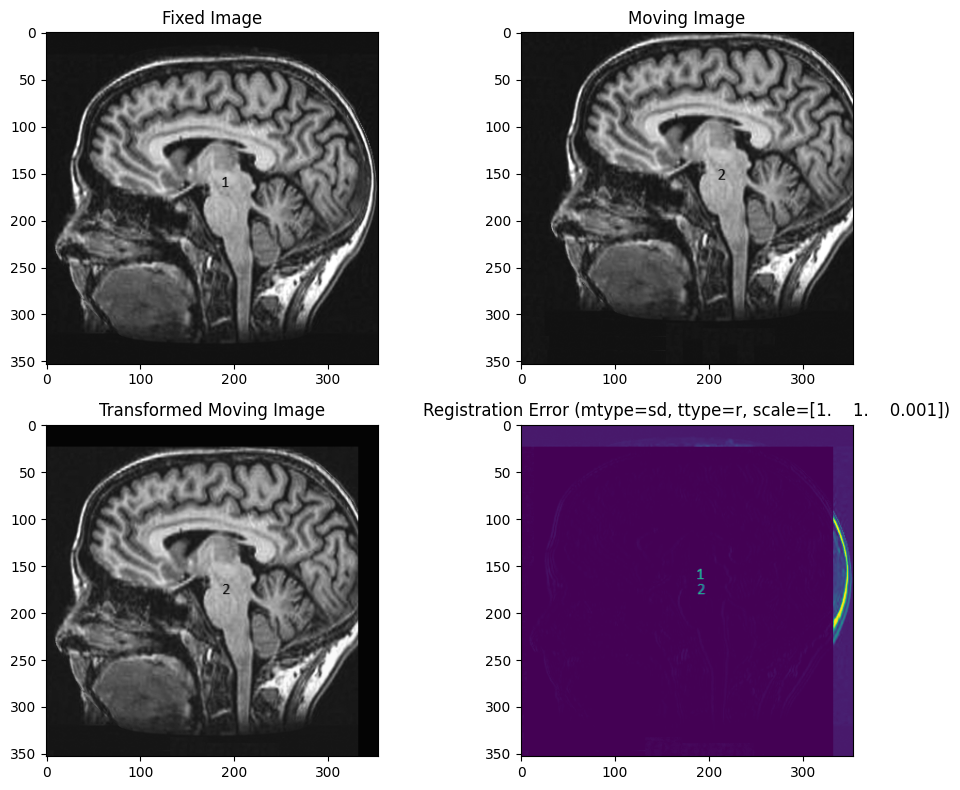


Registration took 13 sec.


In [ ]:
import datetime

start = datetime.datetime.now()
Iregistered, transformation_matrix = affineReg2D("brain2.png", "brain1.png", 'sd', 'r', tscale = [1,1,0.001])
end = datetime.datetime.now()

print(f'\nRegistration took {(end-start).seconds} sec.')

**Inisgths**

Results shown the regid registration using sd as the similarity measure provides good results, however takes 12s to perform

# Let's add some extra functionality to the framework

**TASK 1**: Add two new similarity metrics to the framework:

1.   Normalized cross-correlation (NCC)
2.   Normalized gradient correlation (NGC)

In [ ]:
from scipy.ndimage import sobel, prewitt
from scipy.ndimage import gaussian_filter

def compute_ncc(image1, image2):
    """
    Function called by affine_registration_function() dependen on the mtype parameter
    Compute the Normalized Cross-Correlation (NCC) between two images.

    Parameters:
    image1, image2: Input images (grayscale, same size)

    Returns:
    ncc: Normalized Cross-Correlation value (between -1 and 1)
    """
    # Ensure the images are numpy arrays and of the same shape
    if image1.shape != image2.shape:
        raise ValueError("Images must be of the same shape")

    # Flatten the images to 1D arrays
    image1_flat = image1.flatten()
    image2_flat = image2.flatten()

    # Compute the mean of each image
    mean1 = np.mean(image1_flat)
    mean2 = np.mean(image2_flat)

    # Subtract the mean from each image
    norm_image1 = image1_flat - mean1
    norm_image2 = image2_flat - mean2

    # Compute the numerator: dot product of the normalized images
    numerator = np.sum(norm_image1 * norm_image2)

    # Compute the denominator: product of the norms (standard deviations)
    denominator = np.sqrt(np.sum(norm_image1**2) * np.sum(norm_image2**2))

    # Compute the NCC value
    if denominator == 0:
        return 0  # Avoid division by zero
    ncc = numerator / denominator

    return ncc

def compute_ngc(image1, image2):
    """
    Compute the Normalized Gradient Correlation (NGC) between two images, based on the provided formula.

    Parameters:
    image1, image2: Input images (grayscale, same size)

    Returns:
    ngc: Normalized Gradient Correlation value (between -1 and 1)
    """
    # Ensure the images are numpy arrays and of the same shape
    if image1.shape != image2.shape:
        raise ValueError("Images must be of the same shape")

    # Compute gradients using Sobel filters for both images
    grad_image1_x = sobel(image1, axis=0)  # Gradient in x-direction for image1
    grad_image1_y = sobel(image1, axis=1)  # Gradient in y-direction for image1
    grad_image2_x = sobel(image2, axis=0)  # Gradient in x-direction for image2
    grad_image2_y = sobel(image2, axis=1)  # Gradient in y-direction for image2

    # Numerator: sum of the absolute value of the product of the gradients
    numerator = np.sum(np.abs(grad_image1_x * grad_image2_x + grad_image1_y * grad_image2_y))

    # Denominator: product of the sums of gradient magnitudes
    denominator_image1 = np.sqrt(np.sum(grad_image1_x**2 + grad_image1_y**2))
    denominator_image2 = np.sqrt(np.sum(grad_image2_x**2 + grad_image2_y**2))

    denominator = denominator_image1 * denominator_image2

    # Compute the NGC value
    if denominator == 0:
        return 0  # Avoid division by zero

    ngc = numerator / denominator

    return abs(ngc)

Parameters: [ 2.19531893e+01 -2.39908513e+01  1.41024634e-05]
ncc: -96.50751845608802
MSE: 0.3875539323535684


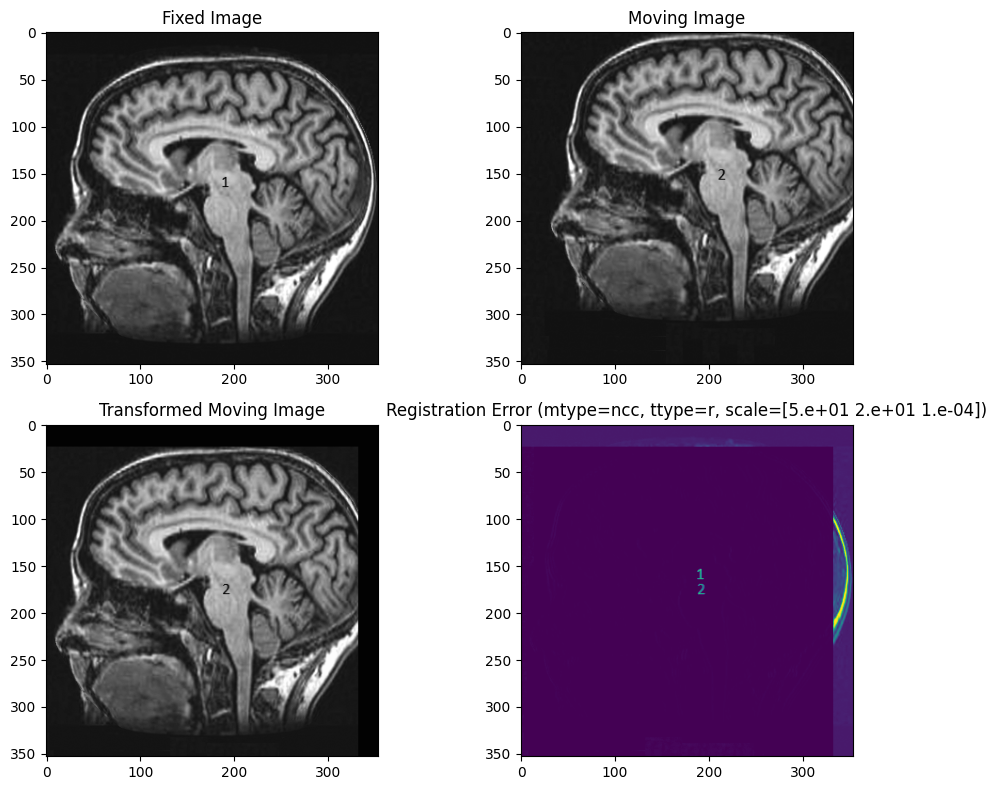


Registration took 7 sec.


In [ ]:
start = datetime.datetime.now()
Iregistered, transformation_matrix = affineReg2D("brain2.png", "brain1.png", 'ncc', 'r', tscale = [50,20,0.0001])
end = datetime.datetime.now()

print(f'\nRegistration took {(end-start).seconds} sec.')

Parameters: [0. 0. 0.]
ngc: -31.83939804132897
MSE: 5.874396752651833


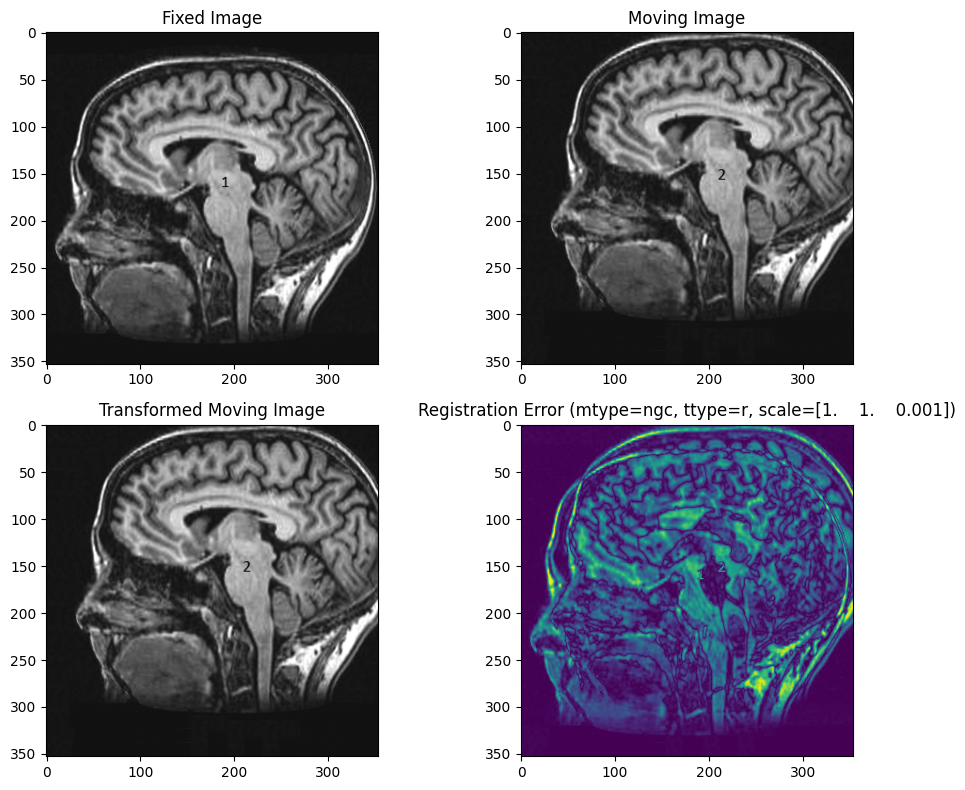


Registration took 3 sec.


In [ ]:
start = datetime.datetime.now()
Iregistered, transformation_matrix = affineReg2D("brain2.png", "brain1.png", 'ngc', 'r', tscale = [1,1,0.001])
end = datetime.datetime.now()

print(f'\nRegistration took {(end-start).seconds} sec.')

**Insigths**

For this rigid transformation between Brain 1 and Brain 2, using the ncc as the metric for the optimization provides better results in terms of quality and time.

**TASK 2**: Modify the framework to be able to deal with full affine 2D transformations.
   - **QUESTION 4**: Justify how you initialize the transformation.

For Affine transformation, the transformation matrix is

$f_x(x, y) = a_x x + a_y y + t_x \\ f_y(x, y) = b_x x + b_y y + t_y'$

Extended the 2D matrix to 3D homogenous form by add extra row and column (0,0,1). This gives the same result as in 2D with exception of extra w coordinate which remains 1. Place the 2D point on the plane w = 1 in 3D space and do operation in this plane but still operation is in 2D. So we get Affine tranformation matrix as follow to include scaling and shearing with 6 components:


In Affine Transform, it has 6 default values
`x = np.array([0, 0, 1, 1, 0, 0]) `





Parameters: [ 2.19907111e+01 -2.39511345e+01  1.00001021e+00  1.00035374e+00
  4.47346102e-05 -3.27810818e-04]
ncc: -96.49476945032472
MSE: 0.3899878207741295


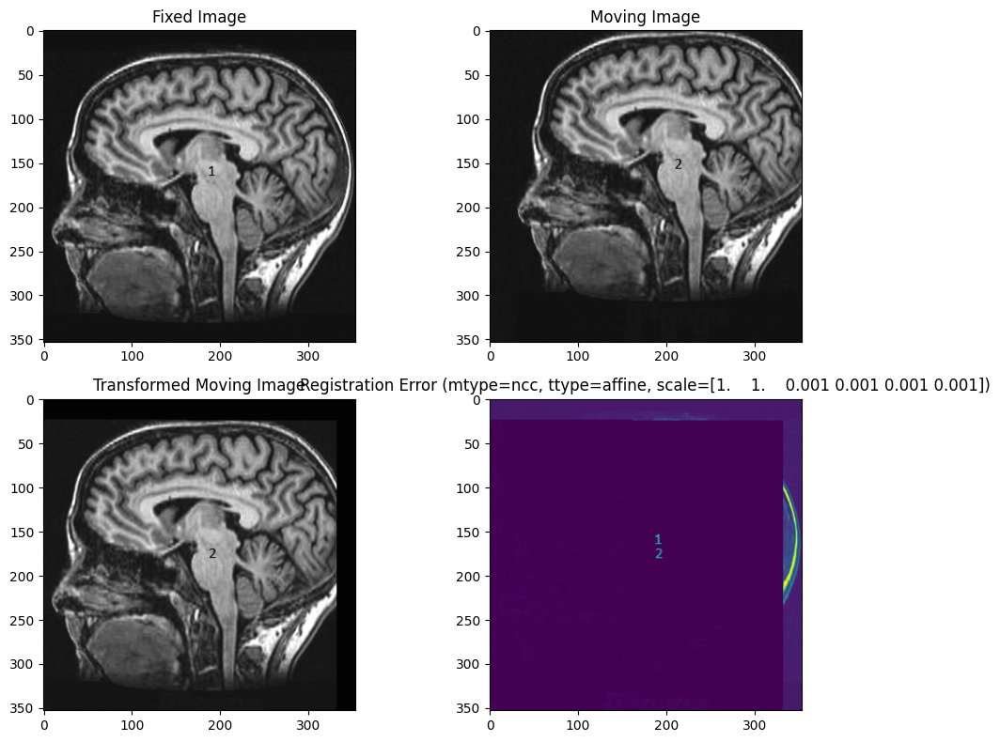


Registration took 13 sec.


In [ ]:
start = datetime.datetime.now()
Iregistered, transformation_matrix = affineReg2D("brain2.png", "brain1.png", mtype = 'ncc', ttype = 'affine', tscale = [1, 1, 0.001, 0.001, 0.001, 0.001])
end = datetime.datetime.now()

print(f'\nRegistration took {(end-start).seconds} sec.')

In [ ]:
transformation_matrix

array([[ 1.00001021e+00,  4.47346102e-05,  2.19907111e+01],
       [-3.27810818e-04,  1.00035374e+00, -2.39511345e+01],
       [ 0.00000000e+00,  0.00000000e+00,  1.00000000e+00]])

**Insigths**

Affine transformation seems to be dependen on different parameters for the transformation matrix. Besides providing good results for the same two images compared to the rigid tranformation it takes more than 3 times the amount of time spent on registration.

**TASK 3**: Implement the above modifications in a multi-resolution registration framework. The number of resolutions should be a parameter of the framework.
  - **QUESTION 5**: Discuss how each resolution is initialized.

**Answer:** From the idea of image pyramid which is start from original image(high resolution) then shrink/downsampling it half size after gaussain filtering multiple time according to `num_level`

  - **QUESTION 6**: Justify the benefits of multi-resolution in terms of computation time and/or accuracy of the final result, compared to a single resolution.


  **Answer:** The advantage of multi-resolution over single resolution is the size of image is much smaller so it leads to less runtime and imporve robustness to noise in the registration as shown in cells below. We trid multi-resolution with Affine transformation with NGC.
  computation time for multiresolution starts from high resolution to low resolution goes form 10 seconds down to 2 seconds (with affine transformation + NGC).
  We can also see that mean sqaure error is also decrease from 5.845% in the high resolution (original image) to 0.43%.


In [ ]:
# modified fucntion to have tranformation matrix as input
def multi_registration(par, scale, Imoving, Ifixed, mtype, ttype, order, trans_mat):
    """
    This function evaluates how well a set of parameters (translation and rotation)
    aligns the two images based on the squared differences metric

    par: parameters that define the transformation
    scale: scaling factor applied to the parameters. helps adjust magnitude of the transformation
    Imoving: moving image
    Ifixed: fixed image
    mtype: metric used to evaluate alignment. squared difference in this case
    ttype: type of transformation. rigid or affine transformation
    order: interpolation order used during image transformation. (Nearest neighbor, bilinear, cubic)
    """
    Imoving = gaussian_filter(Imoving, sigma=1)
    Ifixed = gaussian_filter(Ifixed, sigma=1)

    # Parameters are scaled
    x = par * scale

    # Rigid or affine transformation
    if ttype == 'r':  # Rigid transformation
        # Calculate the new rigid transformation matrix based on the optimized parameters
        M_update = np.array([[np.cos(x[2]), np.sin(x[2]), x[0]],  # rotation + translation
                             [-np.sin(x[2]), np.cos(x[2]), x[1]],
                             [0, 0, 1]])

    elif ttype == 'affine':  # Affine transformation
        # Calculate the new affine transformation matrix based on the optimized parameters
        M_update = np.array([[x[2], x[4], x[0]],  # scaling + shear + translation
                             [x[5], x[3], x[1]],
                             [0, 0, 1]])
    else:
      raise ValueError('Unknown registration type')

    # Combine the initial transformation matrix (trans_mat) with the new update
    M = np.dot(trans_mat, M_update)  # Updated transformation matrix

    # Apply the transformation to the moving image
    I3 = affine_transform_2d_double(Imoving, M, order)  # order controls interpolation

    # Compute the error metric
    if mtype == 'sd':  # Squared differences
        e = np.sum((I3 - Ifixed)**2) / I3.size
    elif mtype == 'ncc':  # Normalized cross-correlation
        e = -compute_ncc(Ifixed, I3)
    elif mtype == 'ngc':  # Normalized gradient correlation
        e = -compute_ngc(Ifixed, I3)
    else:
        raise ValueError('Unknown metric type')
    return e

In [ ]:
def affineMultiReg(Imoving_path, Ifixed_path, mtype, ttype='r', tscale = [1, 0.001, 0.001, 0.001, 0.001, 0.001,1], epsilon=0.001, order=3, trans_mat=None):
    """2D affine image registration between a 'moving' and 'fixed' image"""

    # Read images in gray scale or use passed numpy arrays
    if isinstance(Imoving_path, str):
        Imoving = rgb2gray(imread(Imoving_path)[:,:,0:3]).astype(np.double)
    else:
        Imoving = Imoving_path

    if isinstance(Ifixed_path, str):
        Ifixed = rgb2gray(imread(Ifixed_path)[:,:,0:3]).astype(np.double)
    else:
        Ifixed = Ifixed_path

    scale = np.array(tscale)

    # Initialize transformation parameters
    if ttype == 'r':
        x = np.array([0, 0, 0])  # Initial rigid parameters
        if scale.size != 3:
            raise ValueError('Invalid scale')
    elif ttype == 'affine':
        x = np.array([0, 0, 1, 1, 0, 0])  # Initial affine parameters
        if scale.size != 6:
            raise ValueError('Invalid scale')
    else:
        raise ValueError('Unknown registration type')

    # Scale down transformation parameters for optimization
    x = x / scale

    # Perform optimization using the passed transformation matrix as the initial guess
    result = minimize(
        lambda par: multi_registration(par, scale.astype(np.double), Imoving, Ifixed, mtype, ttype, order, trans_mat),
        x.astype(np.double), options={'eps': epsilon, 'maxls': 50},
        method='L-BFGS-B'
    )

    # Get the optimized parameters
    x = result.x
    x = x * scale  # Convert back to the correct units

    print(f'Optimized Parameters: {x}')
    print(f'{mtype} Error: {(result.fun)*100}')

    # Update the transformation matrix based on optimized parameters
    if ttype == 'r':  # rigid transformation
        M = np.array([[np.cos(x[2]), np.sin(x[2]), x[0]],
                      [-np.sin(x[2]), np.cos(x[2]), x[1]],
                      [0, 0, 1]])
    elif ttype == 'affine':  # affine transformation
        M = np.array([[x[2], x[4], x[0]],
                      [x[5], x[3], x[1]],
                      [0, 0, 1]])

    # Apply the transformation to the moving image
    Icor = affine_transform_2d_double(Imoving, M, order)

    mse_register =  (np.mean((Icor - Ifixed) ** 2))*100

    print(f'MSE: {mse_register}')

    # Show the registration results
    plt.figure(figsize=(10, 8))

    plt.subplot(2, 2, 1)
    plt.imshow(Ifixed, cmap='gray')
    plt.title('Fixed Image')

    plt.subplot(2, 2, 2)
    plt.imshow(Imoving, cmap='gray')
    plt.title('Moving Image')

    plt.subplot(2, 2, 3)
    plt.imshow(Icor, cmap='gray')
    plt.title('Transformed Moving Image')

    plt.subplot(2, 2, 4)
    plt.imshow(np.abs(Ifixed - Icor), cmap='viridis')
    plt.title(f'Registration Error (mtype={mtype}, ttype={ttype}, scale={scale})')

    plt.tight_layout()
    plt.show()

    return Icor, M  # Return the transformed image and the optimized transformation matrix

In [ ]:
from skimage.transform import pyramid_gaussian

def create_image_pyramid(image, number_levels=3):
    return list(pyramid_gaussian(image, max_layer=number_levels, downscale=2))

Imoving = rgb2gray(imread("brain2.png")[:,:,0:3]).astype(np.double)
# print(Imoving.shape)
moving_pyramid = create_image_pyramid(Imoving)
print(f'Number of levels in moving pyramid: {len(moving_pyramid)}')
print(moving_pyramid[0].shape)
print(moving_pyramid[1].shape)
print(moving_pyramid[2].shape)
print(moving_pyramid[3].shape)
Ifixed = rgb2gray(imread("brain1.png")[:,:,0:3]).astype(np.double)
# print(Ifixed.shape)
fixed_pyramid = create_image_pyramid(Ifixed)
# print(fixed_pyramid[1].shape)


Number of levels in moving pyramid: 4
(353, 354)
(177, 177)
(89, 89)
(45, 45)


Parameters: [0. 0. 1. 1. 0. 0.]
ngc: -50.882466228204315
MSE: 3.2977121492193797


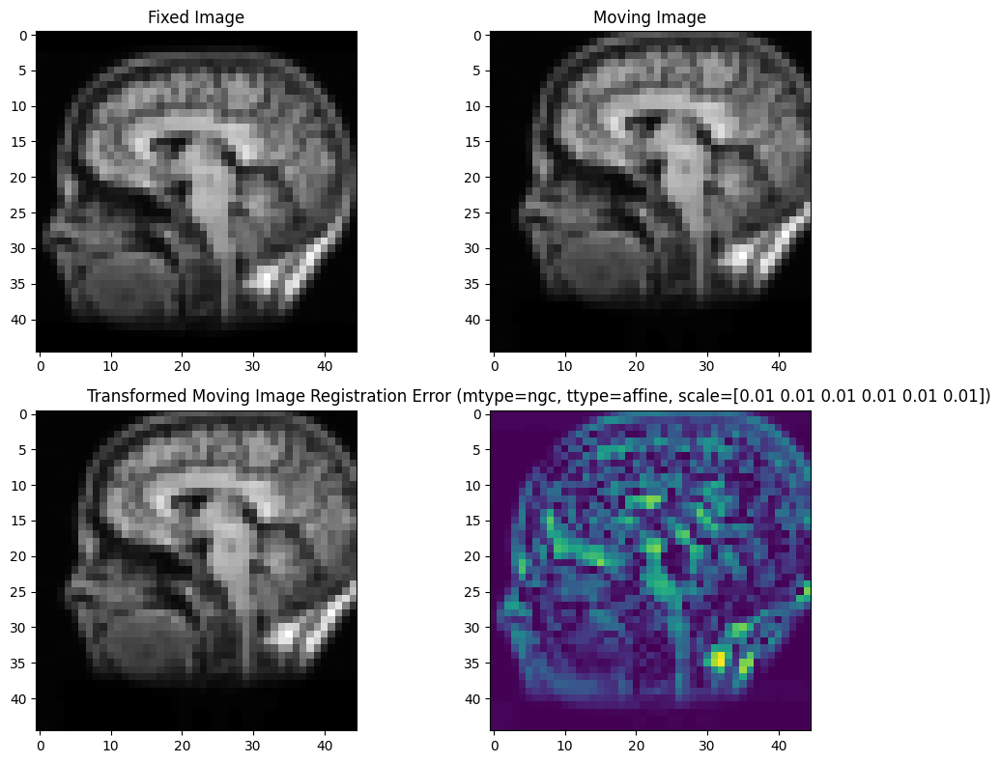

Registration at coarse level took 2 sec.


In [ ]:
# start with high resoluton image (original image)
# moving_pyramid[0], fixed_pyramid[0]

# coarse_tscale = [0.05, 0.09, 0.01, 0.01, 0.01, 0.001]  # Coarse level (larger transformations)

start = datetime.datetime.now()
Iregistered, transformation_matrix = affineReg2D(moving_pyramid[3], fixed_pyramid[3], mtype='ngc', ttype='affine', tscale=[0.01, 0.01, 0.01, 0.01, 0.01, 0.01])
end = datetime.datetime.now()

print(f'Registration at coarse level took {(end - start).seconds} sec.')

In [ ]:
transformation_matrix

array([[1., 0., 0.],
       [0., 1., 0.],
       [0., 0., 1.]])

Optimized Parameters: [0. 0. 1. 1. 0. 0.]
ngc Error: -49.39745613949212
MSE: 4.486509483288172


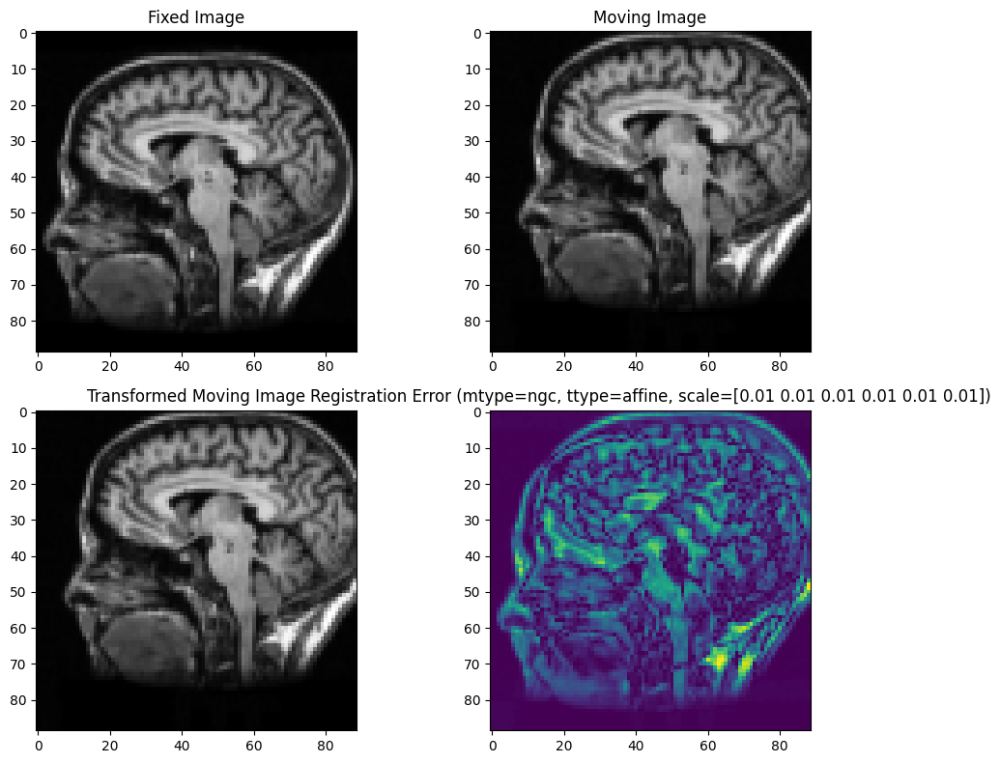

Registration at level 2 took 2 sec.


In [ ]:

medium_tscale = [0.025, 0.045, 0.005, 0.005, 0.005, 0.005]  # Medium level (smaller transformations)

start = datetime.datetime.now()
Iregistered, transformation_matrix = affineMultiReg(moving_pyramid[2], fixed_pyramid[2], mtype='ngc', ttype='affine', tscale=[0.01, 0.01, 0.01, 0.01, 0.01, 0.01], trans_mat=transformation_matrix)
end = datetime.datetime.now()

print(f'Registration at level 2 took {(end - start).seconds} sec.')

In [ ]:
transformation_matrix

array([[1., 0., 0.],
       [0., 1., 0.],
       [0., 0., 1.]])

Optimized Parameters: [0. 0. 1. 1. 0. 0.]
ngc Error: -41.51360680972311
MSE: 5.376175189622037


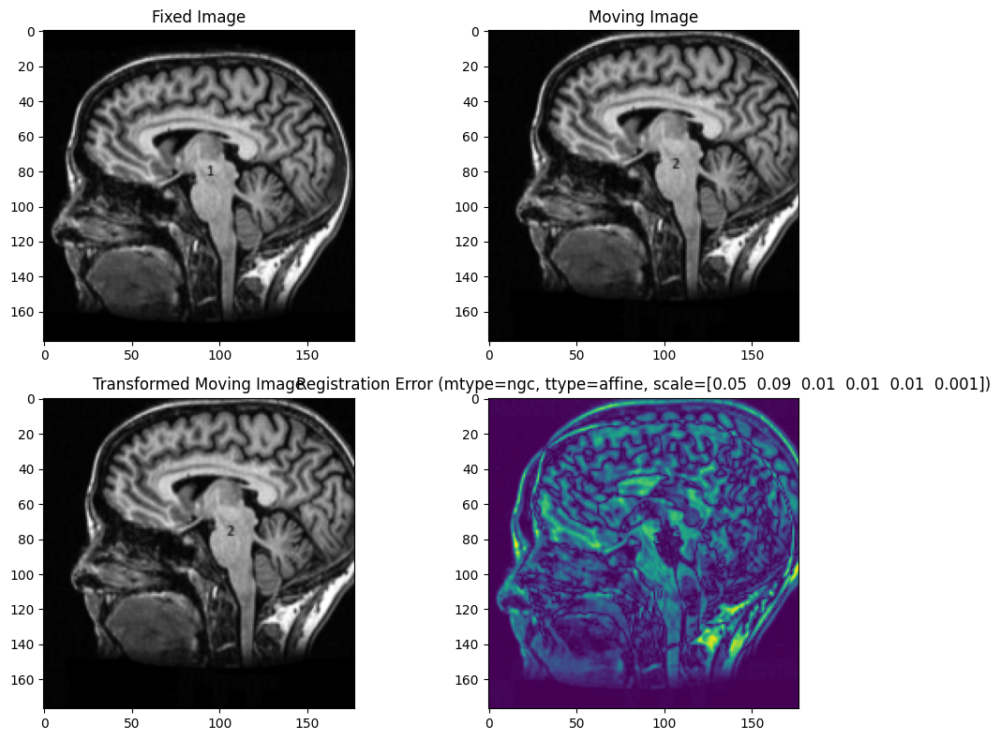

Registration at level 3 took 3 sec.


In [ ]:
start = datetime.datetime.now()
Iregistered, transformation_matrix = affineMultiReg(moving_pyramid[1], fixed_pyramid[1], mtype='ngc', ttype='affine', tscale=[0.05, 0.09, 0.01, 0.01, 0.01, 0.001], trans_mat=transformation_matrix)
end = datetime.datetime.now()

print(f'Registration at level 3 took {(end - start).seconds} sec.')

In [ ]:
transformation_matrix

array([[1., 0., 0.],
       [0., 1., 0.],
       [0., 0., 1.]])

Optimized Parameters: [0. 0. 1. 1. 0. 0.]
ngc Error: -34.38746426061321
MSE: 5.874396752651833


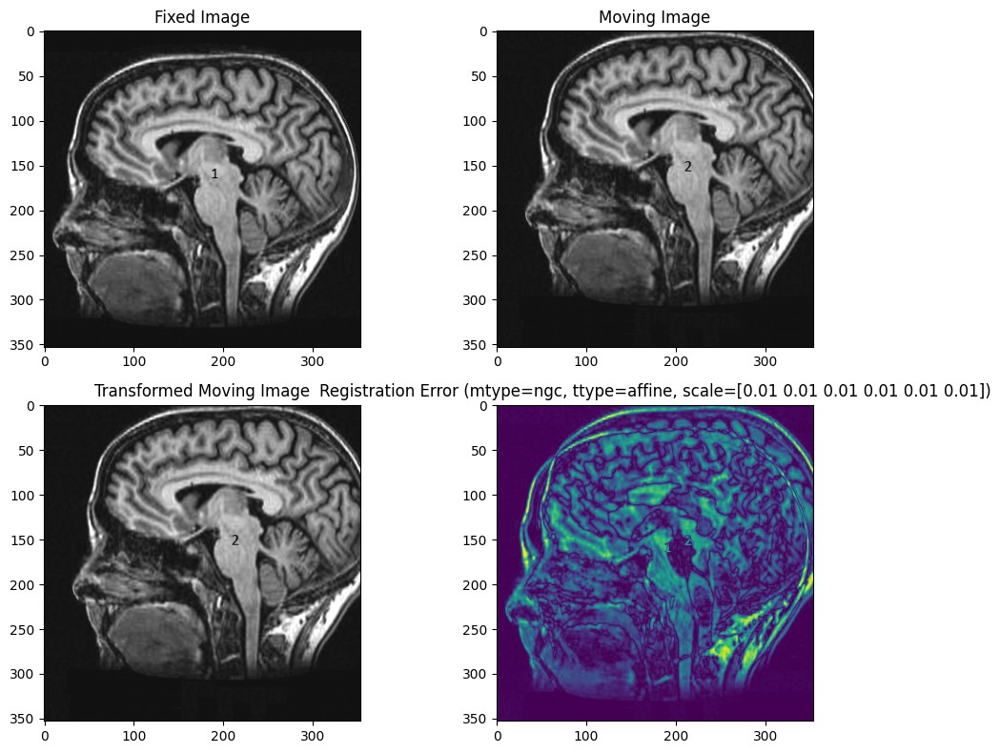

Registration at the finest level took 8 sec.


In [ ]:
start = datetime.datetime.now()
Iregistered, transformation_matrix = affineMultiReg(moving_pyramid[0], fixed_pyramid[0], mtype='ngc', ttype='affine', tscale=[0.01, 0.01, 0.01, 0.01, 0.01, 0.01], trans_mat=transformation_matrix)
end = datetime.datetime.now()

print(f'Registration at the finest level took {(end - start).seconds} sec.')

# Let's try your implementation

**TASK 4**: Show some registration results using brain1.png, brain2.png, brain3.png, and brain4.png with the different combinations of the registration framework: different <u>metrics</u>, <u>transformations</u> and <u>multi-resolution levels</u>.



Combination :
1. Single resolution with Rigid Transformation
  - Brain 2 and Brain 1 with `tscale = [1, 1, 0.001]` showing the SD gives less error than NCC and NGC
  - Brain 3 and Brain 1 with `tscale = [0.01, 1, 1]` showing that SD gives less error compare to NCC and NGC.
  - Brain 4 and Brain 2 with `tscale = [2, 0.001, 0.005]`, NGC gives less error compare to the rest.
2. Single resolution with Affine Transformation
  - Brain 3 and Brain 1 with `tscale = [0.01, 1, 0.001, 0.001, 0.001, 0.001,1]` showing that SD gives less error compare to NCC and NGC.
  - Brain 4 and Brain 2 with `tscale = [0.01, 1, 0.01, 0.001, 0.001, 0.01, 0.01]`, All 3 metrices gave the same MSE.
  - Brain 4 and Brain 1, we tried with different tscale for each similarity metrices. SD gave the best result
3. Multi-resolution with Rigid Transformation
 - Brain 3 and Brain 1 with `tscale = [1, 1, 1] ` NGC gives the most error.

4. Multi-resolution with Affine transformation
  - Brain 2 and Brain 1 with `tscale = [0.05, 0.09, 0.01, 0.01, 0.01, 0.01, 0.001]` NGC error started from 19.42 down to 18.57 with MSE started from 37.605 down to 31.408 overall process took 24s.
  - Brain 3 and Brain 1 with `tscale = [1, 1, 1, 1, 1, 1, 1]` The error goes up and down in all metrices of all NCC, NGC and SD




## Rigid transformation with single resolution

Parameters: [-0.00085352 -0.00694303 -0.3778736 ]
sd: 5.515003983309947
MSE: 5.515003983309947


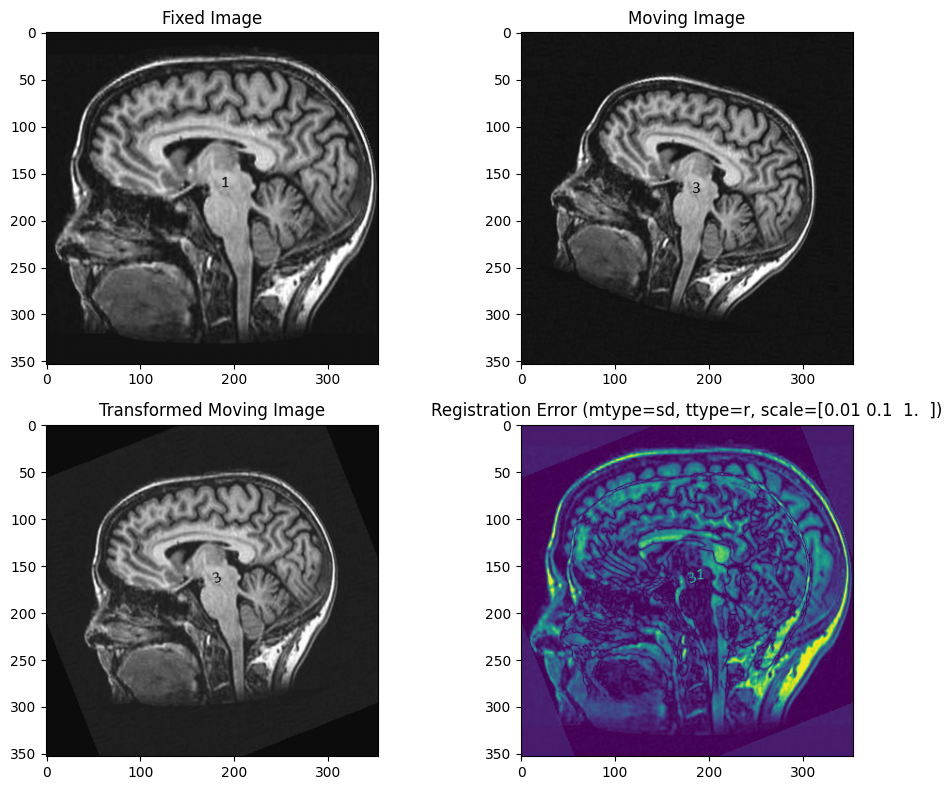


Registration took 5 sec.


In [ ]:
start = datetime.datetime.now()
Iregistered, transformation_matrix = affineReg2D("brain3.png", "brain1.png", 'sd', 'r', tscale = [0.01, 0.1, 1])
end = datetime.datetime.now()

print(f'\nRegistration took {(end-start).seconds} sec.')

Parameters: [ 4.68170380e-04  3.09547946e+00 -3.90216595e-01]
ncc: -50.104698499827485
MSE: 5.464208362158785


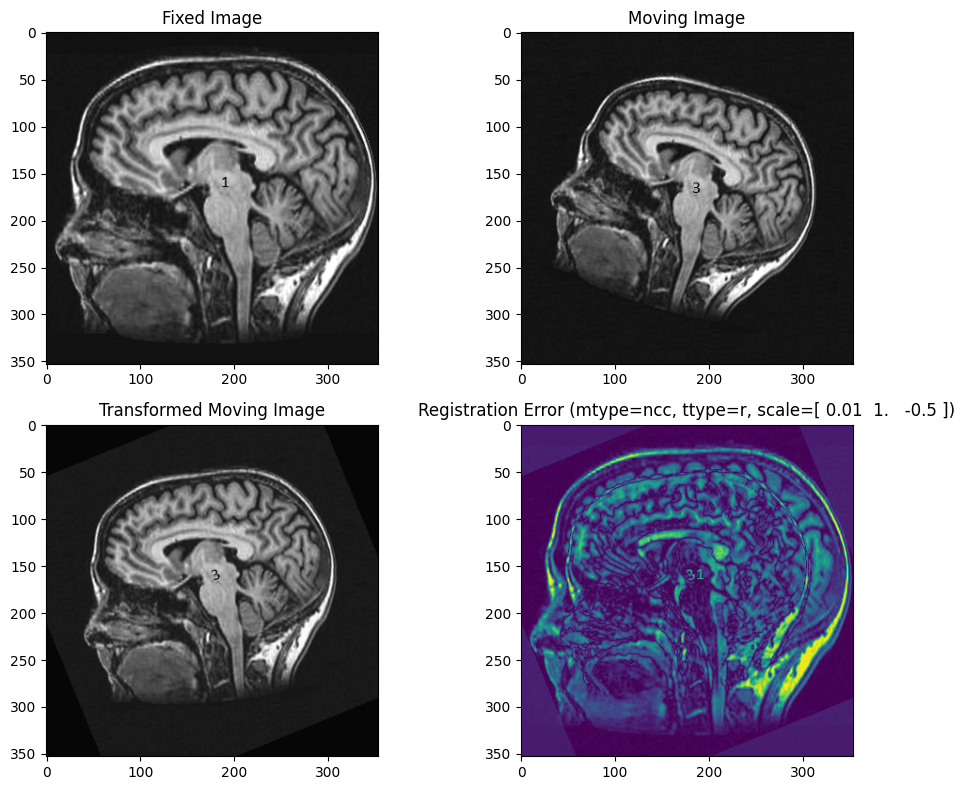


Registration took 18 sec.


In [ ]:
start = datetime.datetime.now()
Iregistered, transformation_matrix = affineReg2D("brain3.png", "brain1.png", 'ncc', 'r', tscale = [0.01, 1, -0.5])
end = datetime.datetime.now()

print(f'\nRegistration took {(end-start).seconds} sec.')

Parameters: [0. 0. 0.]
ngc: -27.61932966216003
MSE: 5.790980198556999


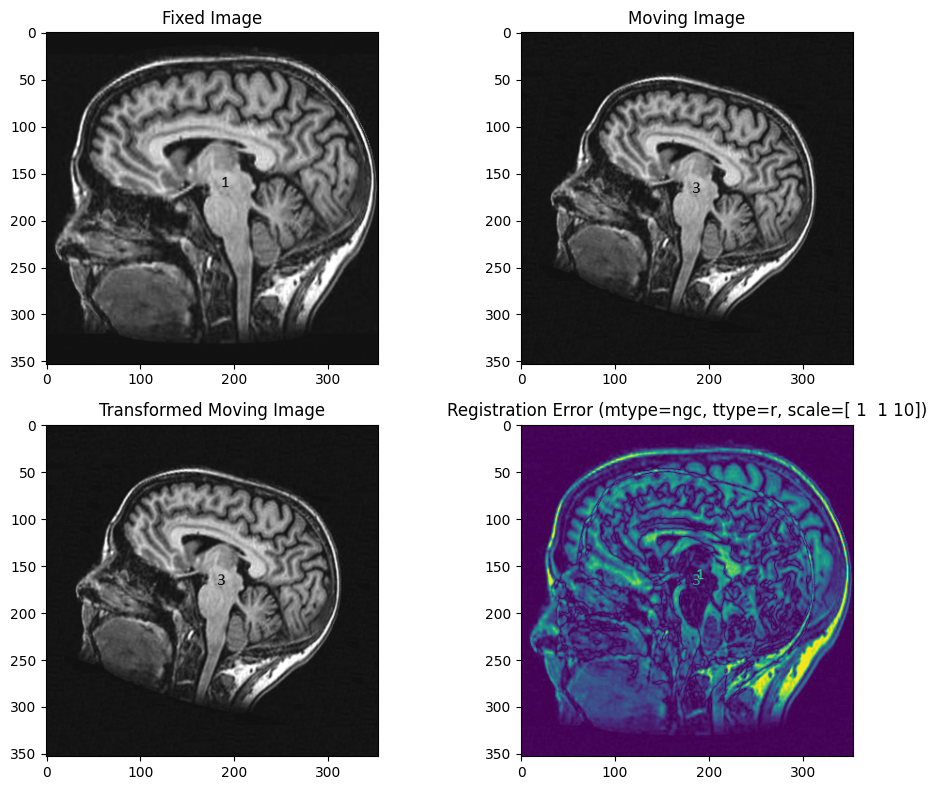


Registration took 4 sec.


In [ ]:
start = datetime.datetime.now()
Iregistered, transformation_matrix = affineReg2D("brain3.png", "brain1.png", 'ngc', 'r', tscale = [1, 1, 10])
end = datetime.datetime.now()
print(f'\nRegistration took {(end-start).seconds} sec.')

Parameters: [ 0.11679604 -0.00278763 -0.74321084]
sd: 26.699154996206826
MSE: 26.699154996206826


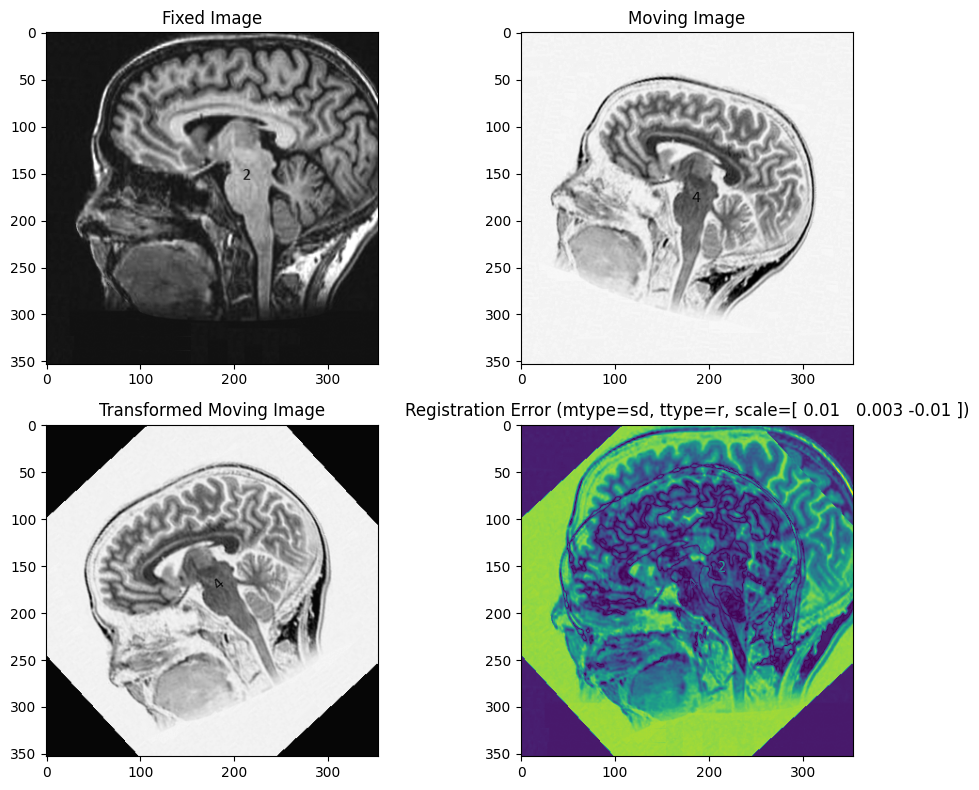


Registration took 4 sec.


In [ ]:
start = datetime.datetime.now()
Iregistered, transformation_matrix = affineReg2D("brain4.png", "brain2.png", 'sd', 'r', tscale = [0.01, 0.003, -0.01])
end = datetime.datetime.now()

print(f'\nRegistration took {(end-start).seconds} sec.')

Parameters: [ 3.34825528e+01 -3.19978765e-02 -6.72413886e-01]
ncc: -8.764733370675447
MSE: 27.200127775866427


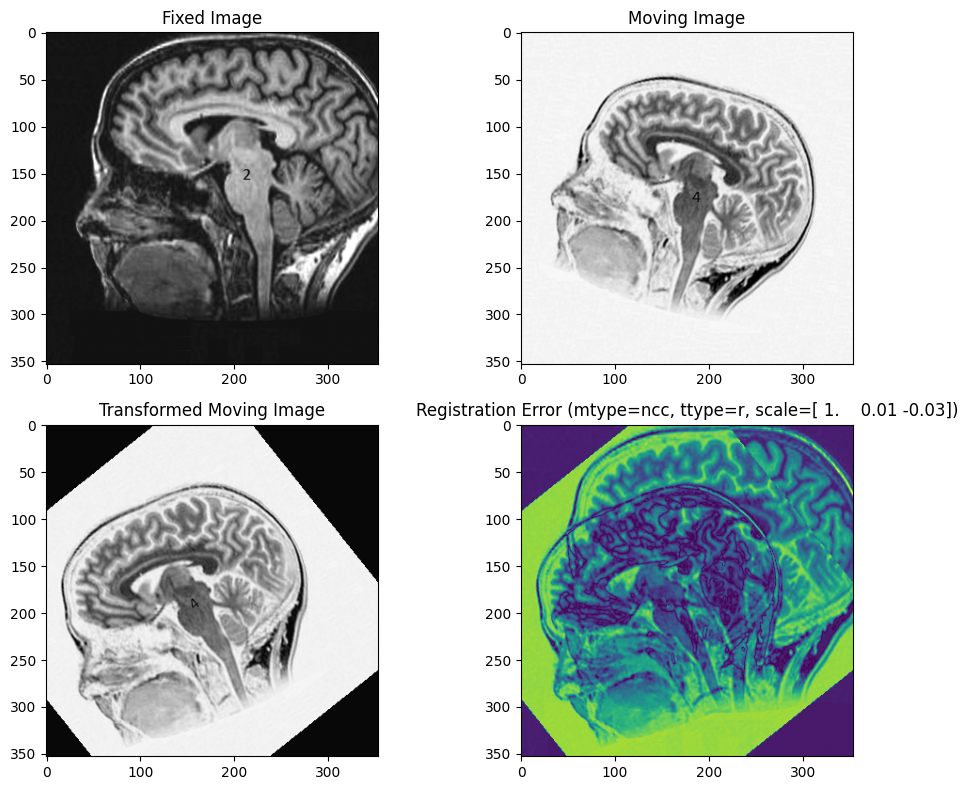


Registration took 8 sec.


In [ ]:
start = datetime.datetime.now()
Iregistered, transformation_matrix = affineReg2D("brain4.png", "brain2.png", 'ncc', 'r', tscale = [1, 0.01, -0.03])
end = datetime.datetime.now()

print(f'\nRegistration took {(end-start).seconds} sec.')

Parameters: [0. 0. 0.]
ngc: -27.472351673104743
MSE: 38.50272155835175


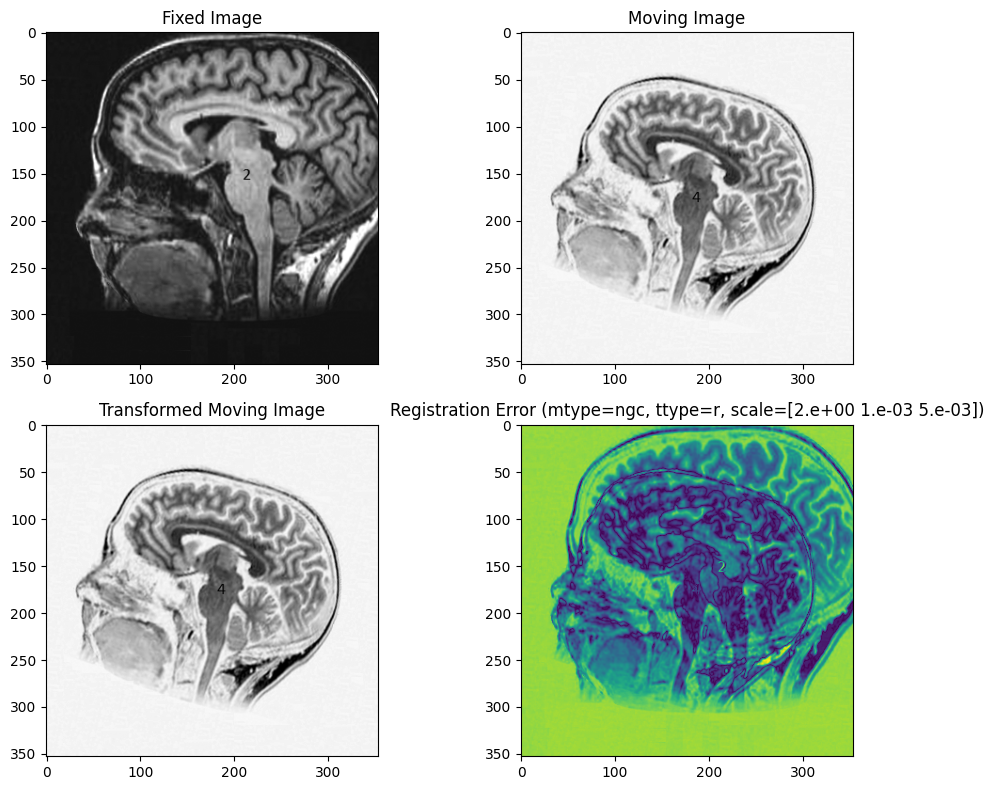


Registration took 2 sec.


In [ ]:
start = datetime.datetime.now()
Iregistered, transformation_matrix = affineReg2D("brain4.png", "brain2.png", 'ngc', 'r', tscale = [2, 0.001, 0.005])
end = datetime.datetime.now()

print(f'\nRegistration took {(end-start).seconds} sec.')

## Rigid transformation with multi resolution

Rigid + SD

In [ ]:
Imoving = rgb2gray(imread("brain3.png")[:,:,0:3]).astype(np.double)
Ifixed = rgb2gray(imread("brain1.png")[:,:,0:3]).astype(np.double)

moving_pyramid = create_image_pyramid(Imoving)
fixed_pyramid = create_image_pyramid(Ifixed)

Parameters: [-1.11408536  0.81793173 -0.391439  ]
sd: 3.10018166144295
MSE: 3.10018166144295


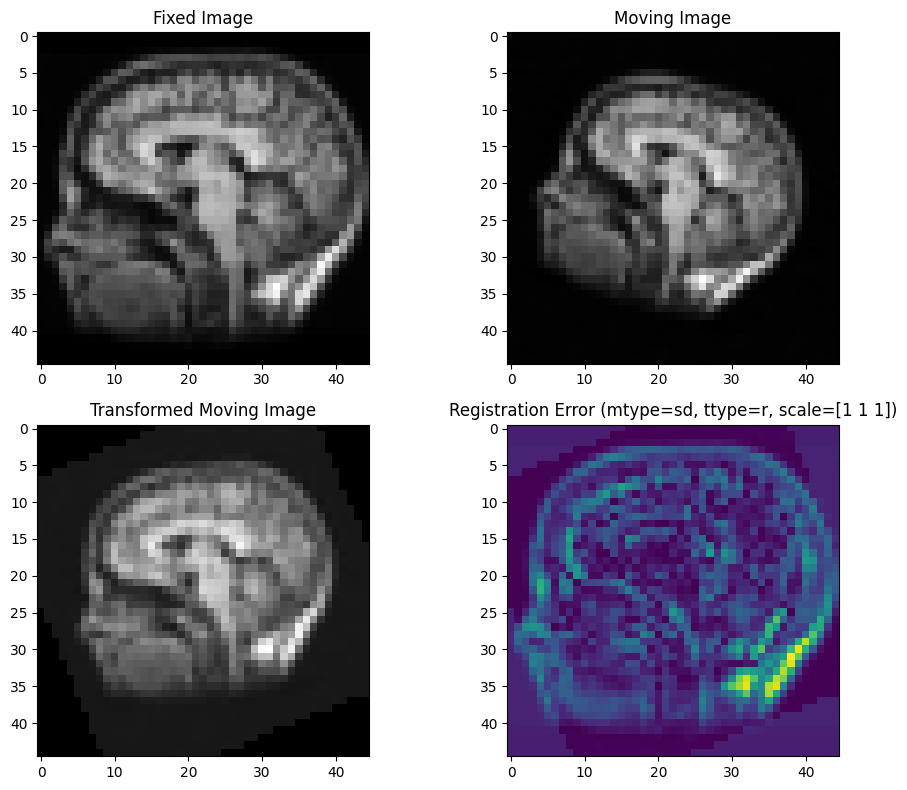

Registration at coarse level took 1 sec.


In [ ]:

start = datetime.datetime.now()
Iregistered, transformation_matrix = affineReg2D(moving_pyramid[3], fixed_pyramid[3], mtype='sd', ttype='r', tscale=[1,1,1] )
end = datetime.datetime.now()

print(f'Registration at coarse level took {(end - start).seconds} sec.')

Optimized Parameters: [-0.01769052  0.01535367  0.01074863]
sd Error: 2.8243177901040974
MSE: 4.498499729118312


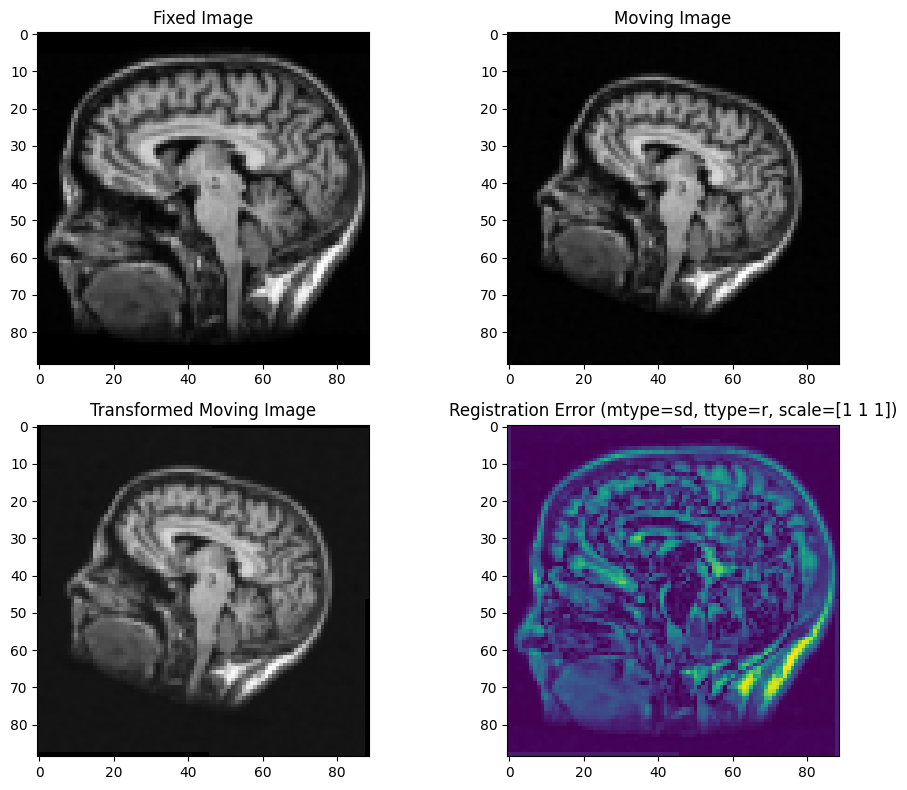

Registration at coarse level took 1 sec.


In [ ]:
# coarse_tscale = [1,1,0.001]  # Coarse level (larger transformations)

start = datetime.datetime.now()
Iregistered, transformation_matrix = affineMultiReg(moving_pyramid[2], fixed_pyramid[2], mtype='sd', ttype='r',  tscale=[1,1,1], trans_mat=transformation_matrix)
end = datetime.datetime.now()

print(f'Registration at coarse level took {(end - start).seconds} sec.')

Optimized Parameters: [-6.57281529  3.22558665 -0.23787283]
sd Error: 3.8140681076830356
MSE: 4.860113232710611


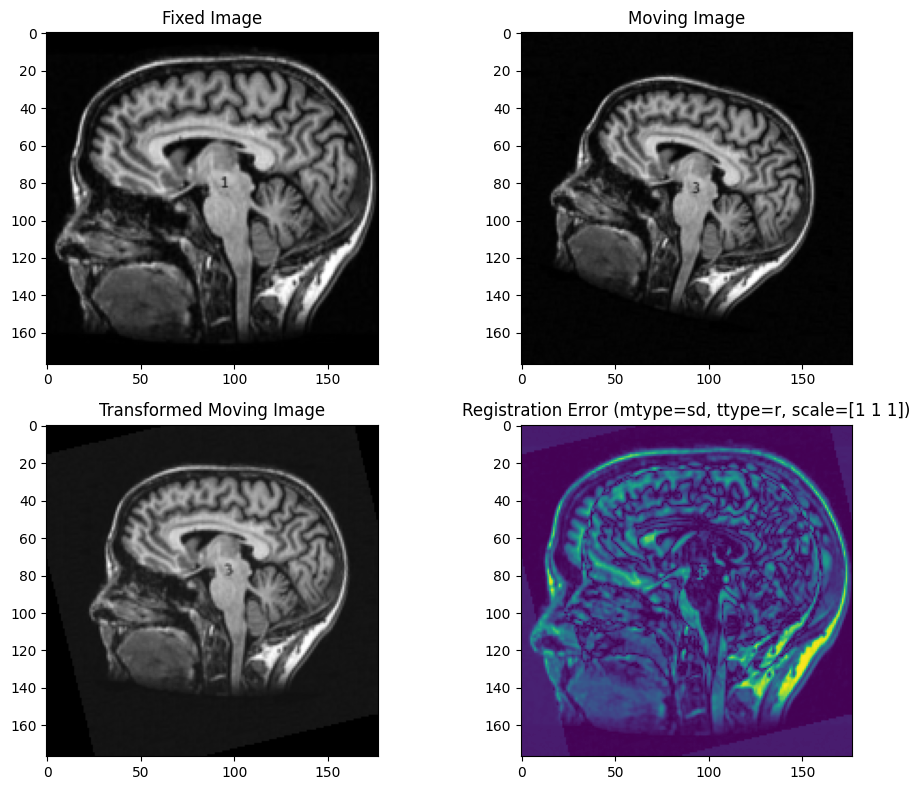

Registration at coarse level took 3 sec.


In [ ]:
# coarse_tscale = [1,1,0.001]  # Coarse level (larger transformations)

start = datetime.datetime.now()
Iregistered, transformation_matrix = affineMultiReg(moving_pyramid[1], fixed_pyramid[1], mtype='sd', ttype='r',  tscale=[1,1,1], trans_mat=transformation_matrix)
end = datetime.datetime.now()

print(f'Registration at coarse level took {(end - start).seconds} sec.')

Optimized Parameters: [-0.00457851  0.00094412 -0.18150381]
sd Error: 4.744424743592016
MSE: 5.772186060069048


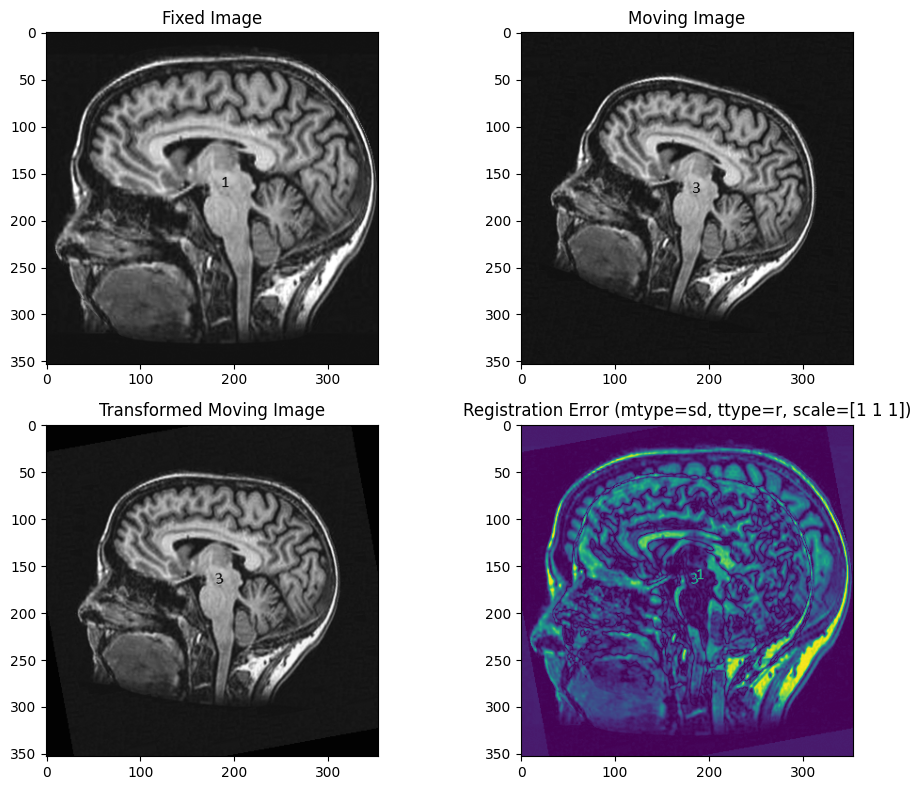

Registration at coarse level took 5 sec.


In [ ]:
# coarse_tscale = [1,1,0.001]  # Coarse level (larger transformations)

start = datetime.datetime.now()
Iregistered, transformation_matrix = affineMultiReg(moving_pyramid[0], fixed_pyramid[0], mtype='sd', ttype='r',  tscale=[1,1,1], trans_mat=transformation_matrix)
end = datetime.datetime.now()

print(f'Registration at coarse level took {(end - start).seconds} sec.')

Rigid + NCC

Parameters: [-0.97914476  0.7785932   0.88876198]
ncc: -63.59765859737
MSE: 3.4451681673186845


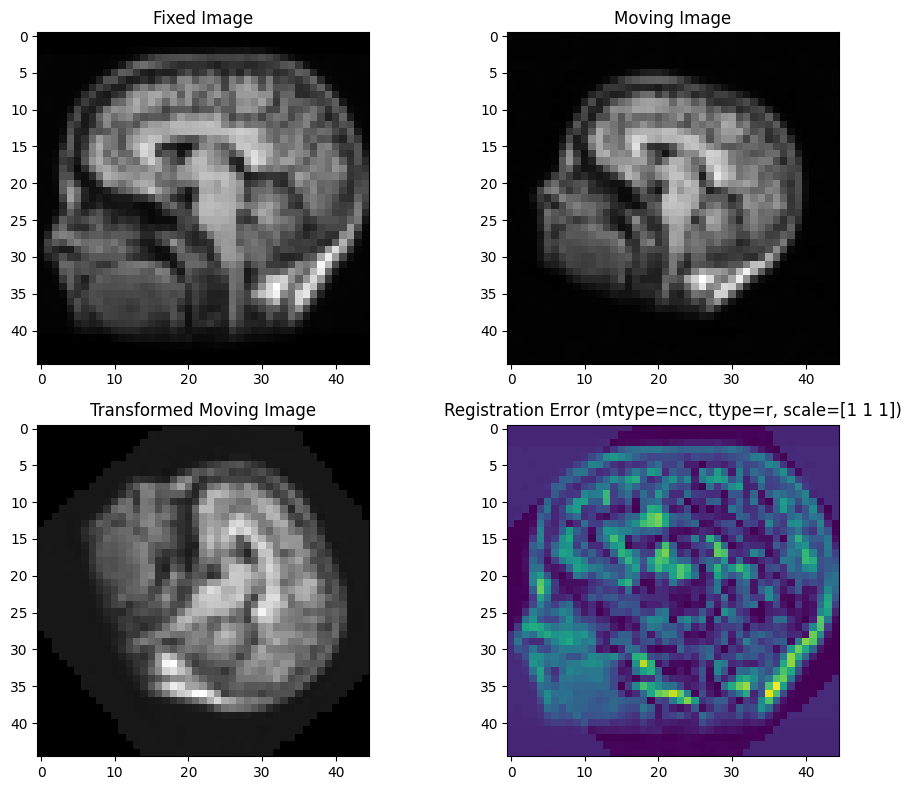

Registration at coarse level took 1 sec.


In [ ]:
# coarse_tscale = [1,1,0.001]  # Coarse level (larger transformations)

start = datetime.datetime.now()
Iregistered, transformation_matrix = affineReg2D(moving_pyramid[3], fixed_pyramid[3], mtype='ncc', ttype='r', tscale=[1,1,1])
end = datetime.datetime.now()

print(f'Registration at coarse level took {(end - start).seconds} sec.')

Optimized Parameters: [-0.88600168  0.69229365 -0.03325918]
ncc Error: -65.48942875971436
MSE: 4.328085437980258


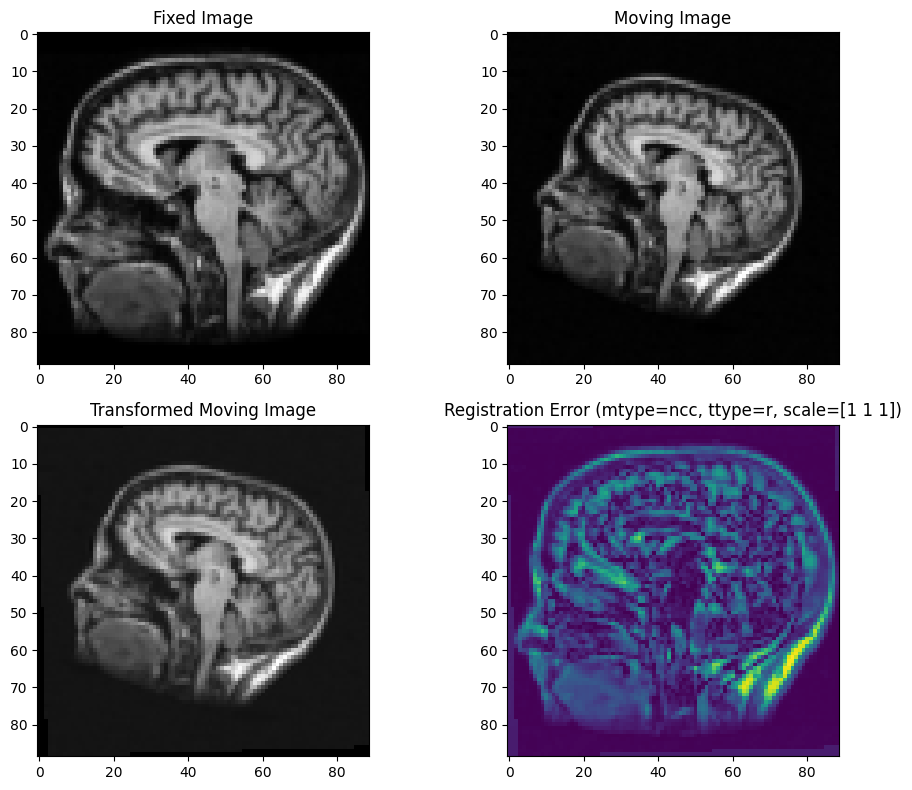

Registration at coarse level took 1 sec.


In [ ]:

start = datetime.datetime.now()
Iregistered, transformation_matrix = affineMultiReg(moving_pyramid[2], fixed_pyramid[2], mtype='ncc', ttype='r',  tscale=[1,1,1], trans_mat=transformation_matrix)
end = datetime.datetime.now()

print(f'Registration at coarse level took {(end - start).seconds} sec.')

Optimized Parameters: [-2.52540252  1.55787818 -0.39439341]
ncc Error: -60.857505681761445
MSE: 4.922391293160292


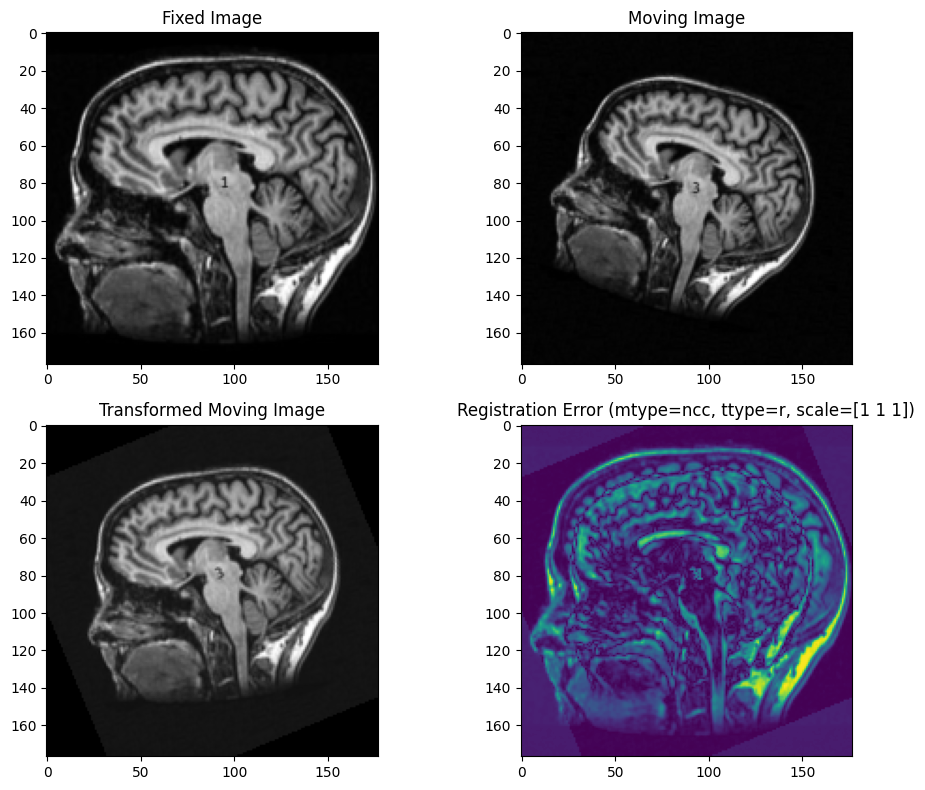

Registration at coarse level took 3 sec.


In [ ]:

start = datetime.datetime.now()
Iregistered, transformation_matrix = affineMultiReg(moving_pyramid[1], fixed_pyramid[1], mtype='ncc', ttype='r',  tscale=[1,1,1], trans_mat=transformation_matrix)
end = datetime.datetime.now()

print(f'Registration at coarse level took {(end - start).seconds} sec.')

Optimized Parameters: [-0.00021492  0.00046736 -0.00835633]
ncc Error: -54.24424143261422
MSE: 5.777262222021812


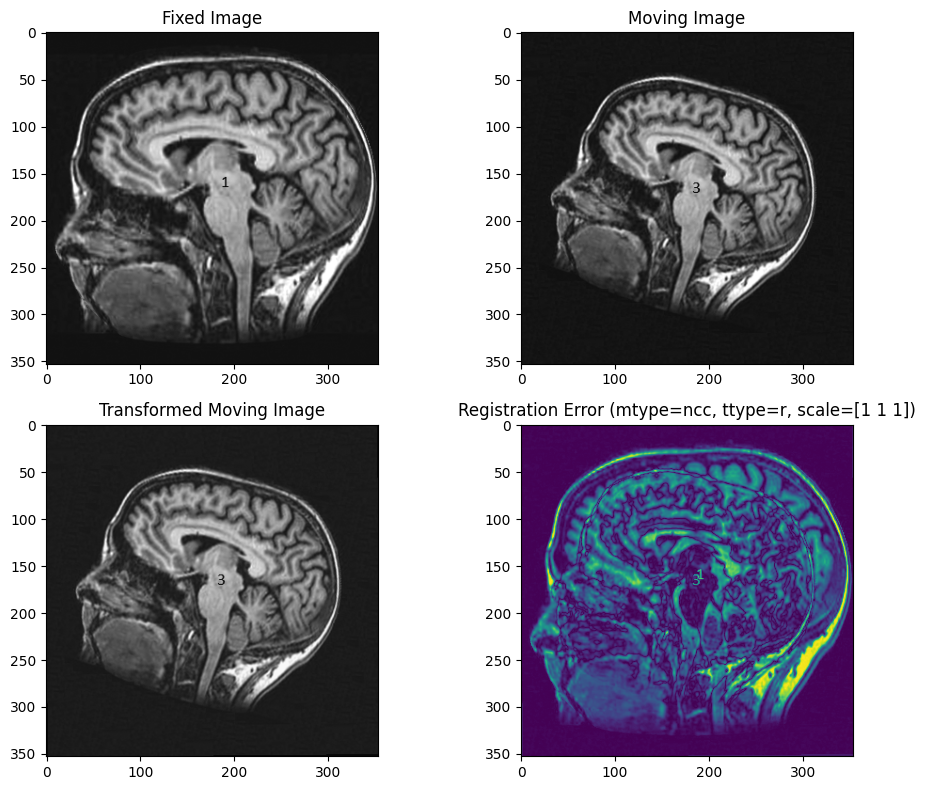

Registration at coarse level took 6 sec.


In [ ]:

start = datetime.datetime.now()
Iregistered, transformation_matrix = affineMultiReg(moving_pyramid[0], fixed_pyramid[0], mtype='ncc', ttype='r',  tscale=[1,1,1], trans_mat=transformation_matrix)
end = datetime.datetime.now()

print(f'Registration at coarse level took {(end - start).seconds} sec.')

Rigid + NGC

Parameters: [-2.97747113 -3.09966379 -0.26974136]
ngc: -54.48000852278887
MSE: 3.247553763917521


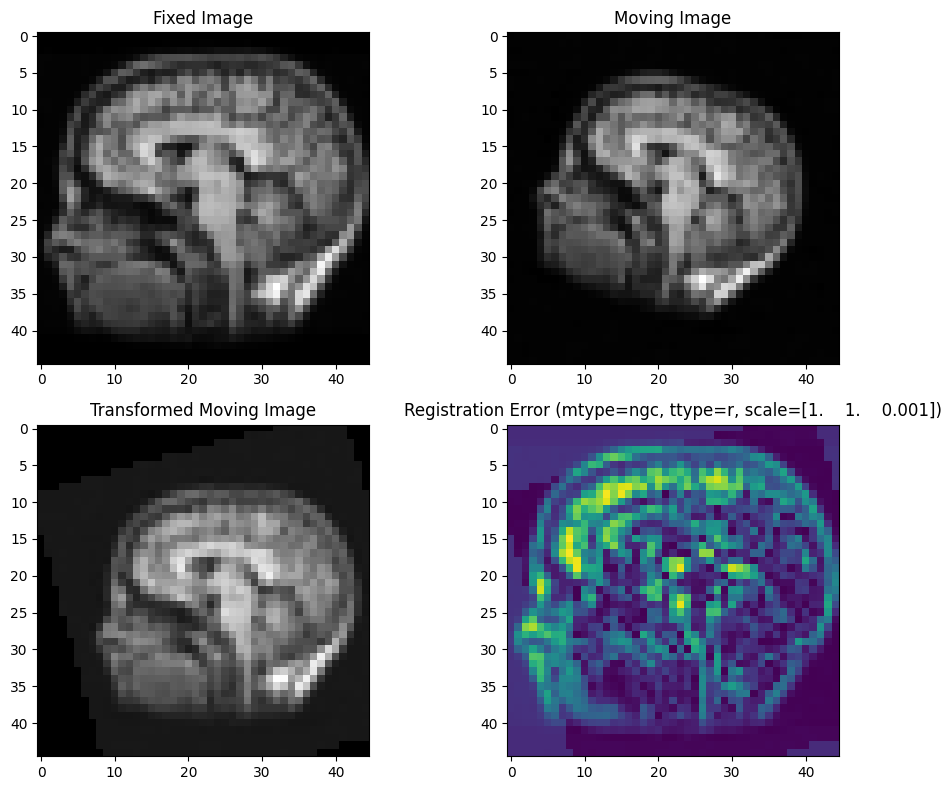

Registration at coarse level took 4 sec.


In [ ]:
coarse_tscale = [1,1,0.001]  # Coarse level (larger transformations)

start = datetime.datetime.now()
Iregistered, transformation_matrix = affineReg2D(moving_pyramid[3], fixed_pyramid[3], mtype='ngc', ttype='r', tscale=coarse_tscale)
end = datetime.datetime.now()

print(f'Registration at coarse level took {(end - start).seconds} sec.')

Optimized Parameters: [-4.03854150e+00 -1.68505231e+00  1.27225859e-04]
ngc Error: -51.315999950350545
MSE: 4.374373317586579


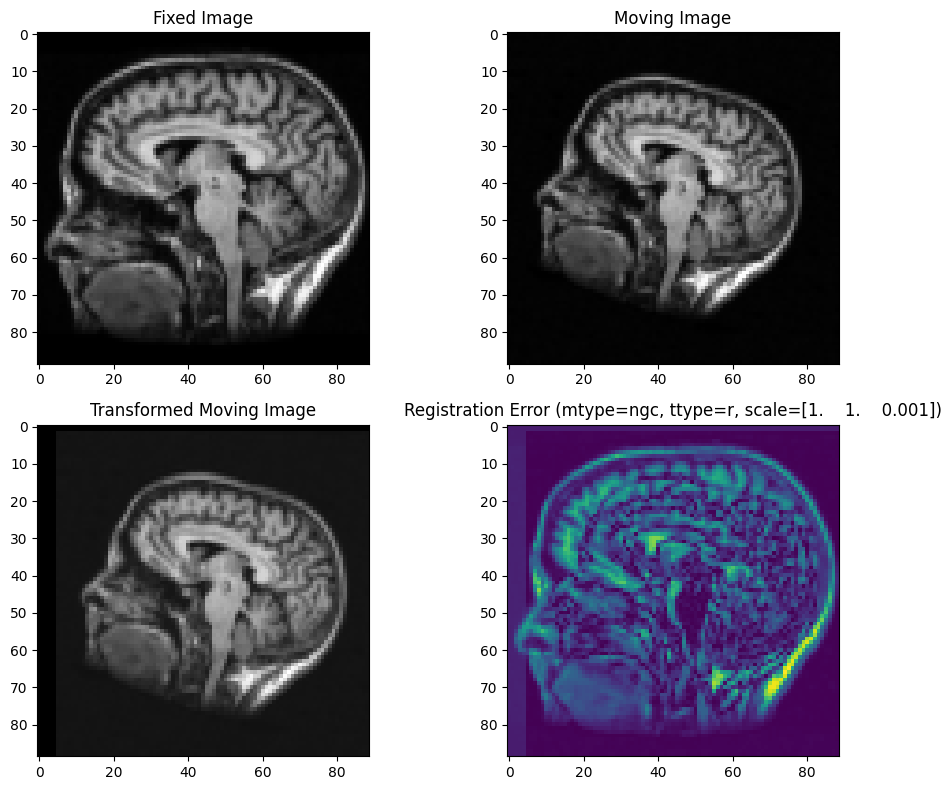

Registration at coarse level took 1 sec.


In [ ]:

start = datetime.datetime.now()
Iregistered, transformation_matrix = affineMultiReg(moving_pyramid[2], fixed_pyramid[2], mtype='ngc', ttype='r',  tscale=coarse_tscale, trans_mat=transformation_matrix)
end = datetime.datetime.now()

print(f'Registration at coarse level took {(end - start).seconds} sec.')

Optimized Parameters: [-7.20445128e+00  1.96839531e+01  1.27979432e-03]
ngc Error: -35.7078803023937
MSE: 5.732683122090969


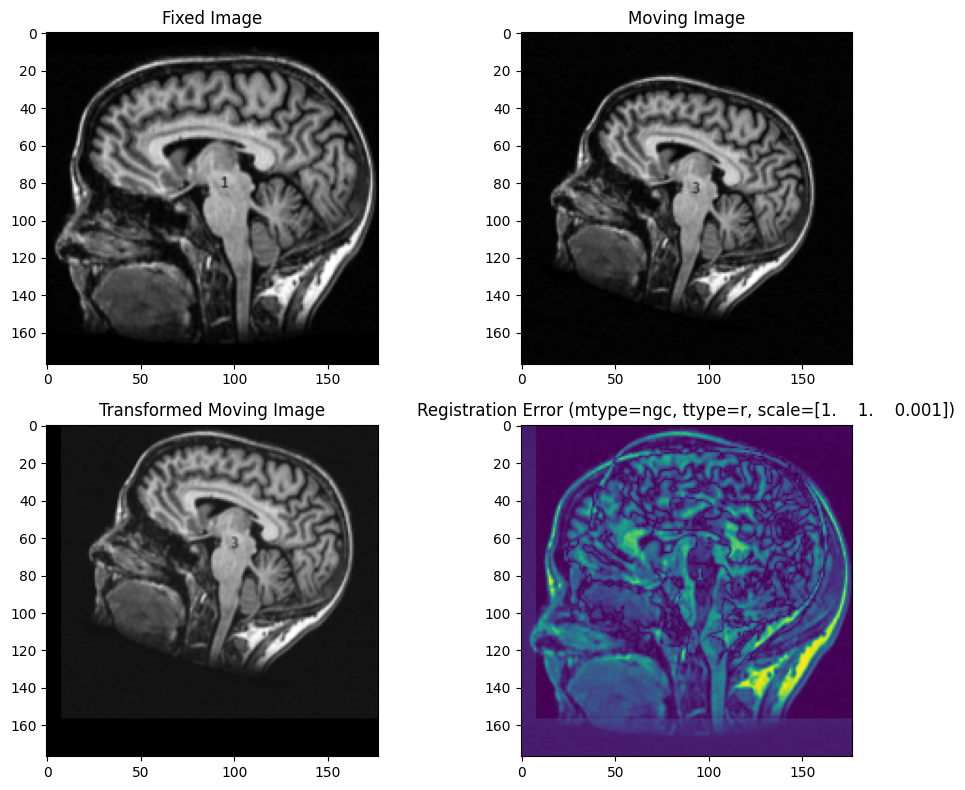

Registration at coarse level took 1 sec.


In [ ]:

start = datetime.datetime.now()
Iregistered, transformation_matrix = affineMultiReg(moving_pyramid[1], fixed_pyramid[1], mtype='ngc', ttype='r',  tscale=coarse_tscale, trans_mat=transformation_matrix)
end = datetime.datetime.now()

print(f'Registration at coarse level took {(end - start).seconds} sec.')

Optimized Parameters: [ 3.39106969e+01 -5.47442174e+00  2.44187245e-02]
ngc Error: -32.8960752044406
MSE: 6.657698192060643


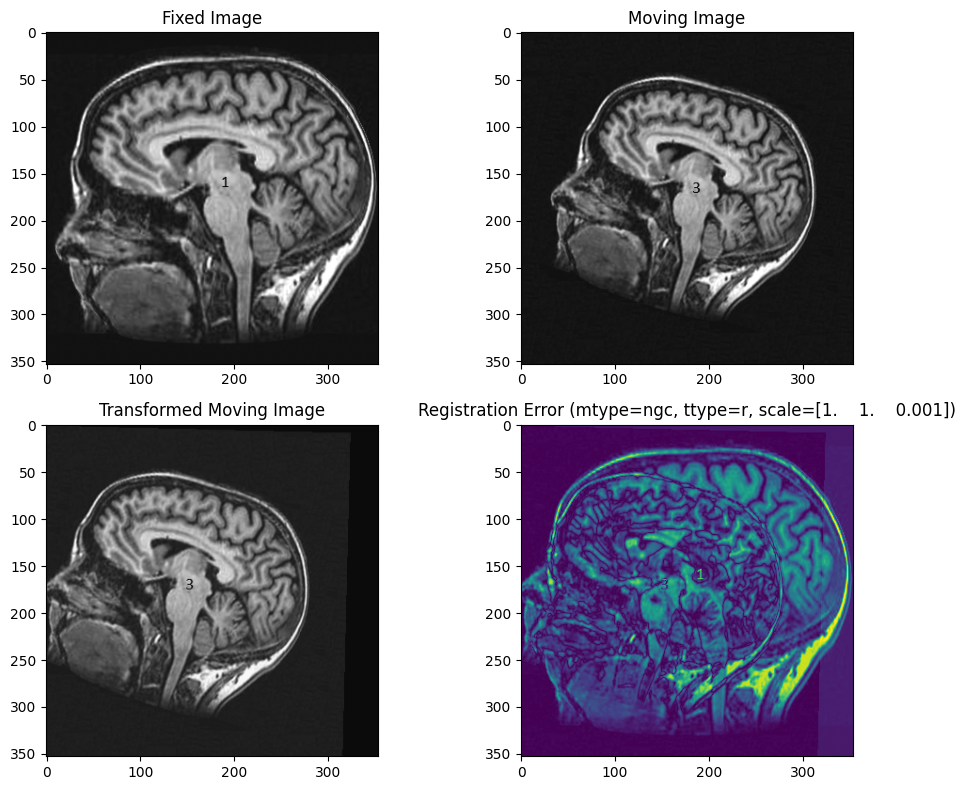

Registration at coarse level took 11 sec.


In [ ]:

start = datetime.datetime.now()
Iregistered, transformation_matrix = affineMultiReg(moving_pyramid[0], fixed_pyramid[0], mtype='ngc', ttype='r',  tscale=coarse_tscale, trans_mat=transformation_matrix)
end = datetime.datetime.now()

print(f'Registration at coarse level took {(end - start).seconds} sec.')

## Affine transformtion + Single transformation

Parameters: [-0.40251466 -4.13435837  0.13908675  0.75233449  0.77066325  0.13967173
  0.16725677]
sd Error: 2.00168153219522
MSE: 2.00168153219522


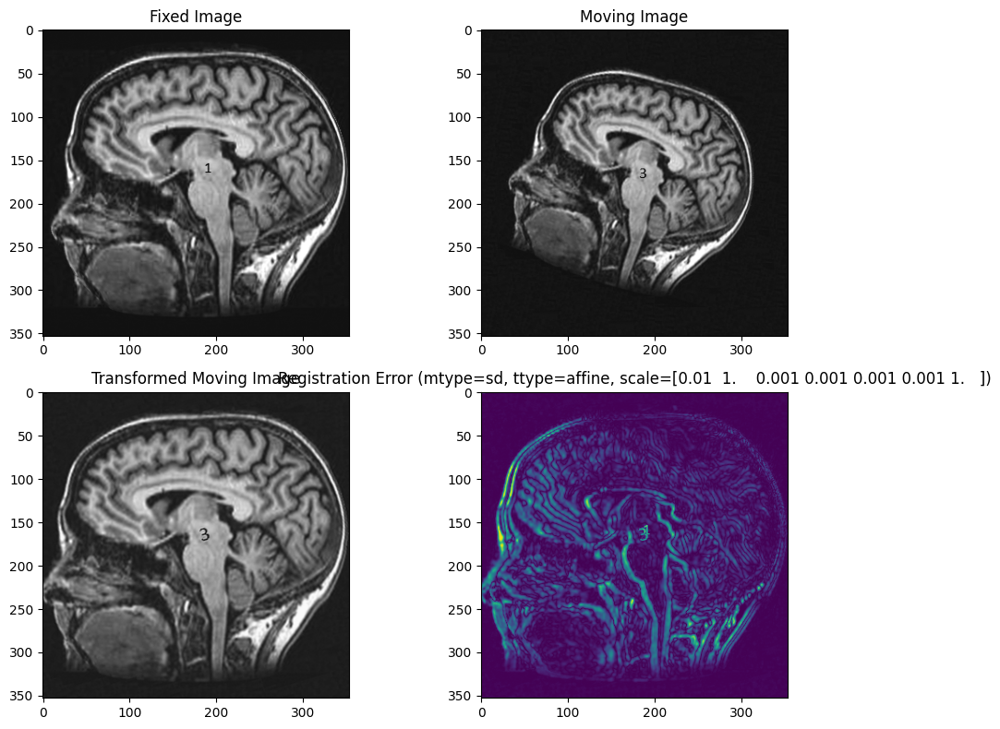


Registration took 29 sec.


In [ ]:
start = datetime.datetime.now()
Iregistered, transformation_matrix = affineReg2D("brain3.png", "brain1.png", 'sd', 'affine', tscale = [0.01, 1, 0.001, 0.001, 0.001, 0.001,1])
end = datetime.datetime.now()

print(f'\nRegistration took {(end-start).seconds} sec.')

Parameters: [ 0.26921198 13.47823356  0.08830786  0.80470223  1.04200548  0.0735769
  0.42414092]
ncc Error: 44.422097270818995
MSE: 4.791736660553031


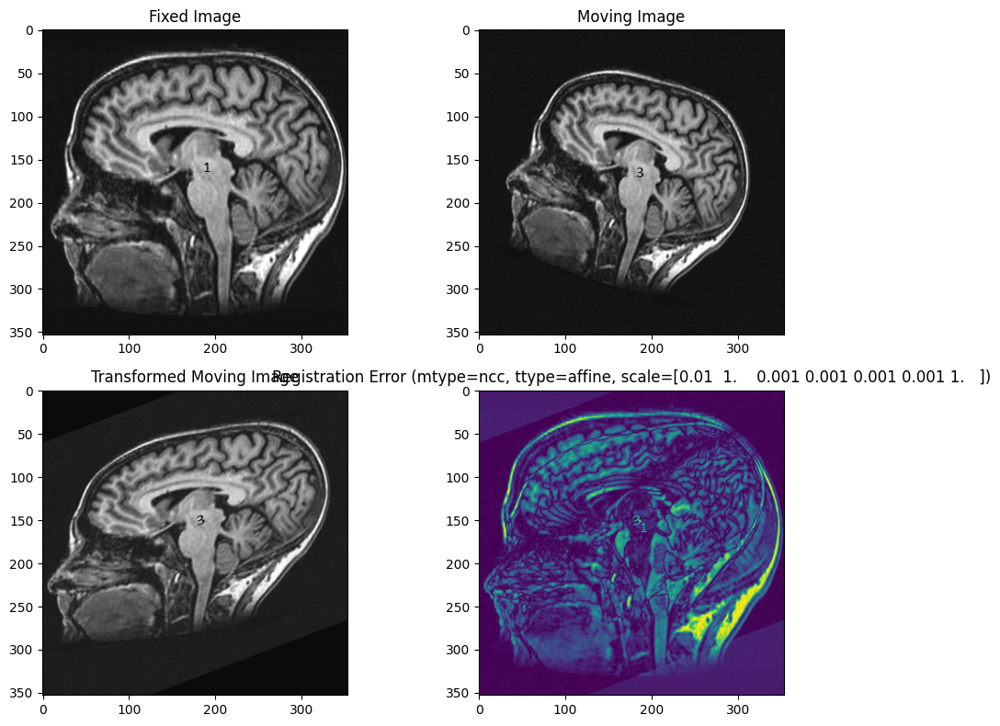


Registration took 33 sec.


In [ ]:
start = datetime.datetime.now()
Iregistered, transformation_matrix = affineReg2D("brain3.png", "brain1.png", 'ncc', 'affine', tscale = [0.01, 1, 0.001, 0.001, 0.001, 0.001,1])
end = datetime.datetime.now()

print(f'\nRegistration took {(end-start).seconds} sec.')

Parameters: [5.03262317e-04 1.05237035e-01 1.53881219e-04 1.00013979e+00
 1.00020224e+00 5.12662388e-05 1.33663816e-01]
ngc Error: 26.46767080490422
MSE: 5.9257354163491245


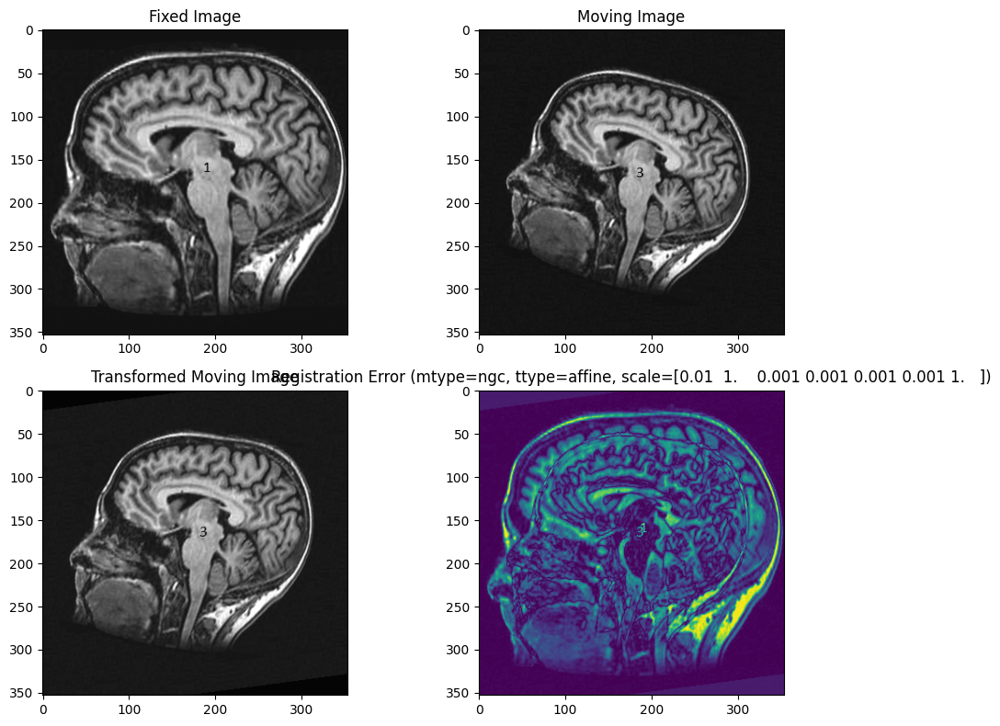


Registration took 9 sec.


In [ ]:
start = datetime.datetime.now()
Iregistered, transformation_matrix = affineReg2D("brain3.png", "brain1.png", 'ngc', 'affine', tscale = [0.01, 1, 0.001, 0.001, 0.001, 0.001,1])
end = datetime.datetime.now()

print(f'\nRegistration took {(end-start).seconds} sec.')

Parameters: [6.62915830e-04 9.24504666e-02 1.66695567e-03 1.00015679e+00
 1.00017795e+00 7.61837388e-04 9.05118383e-04]
sd Error: 38.11819980768141
MSE: 38.11819980768141


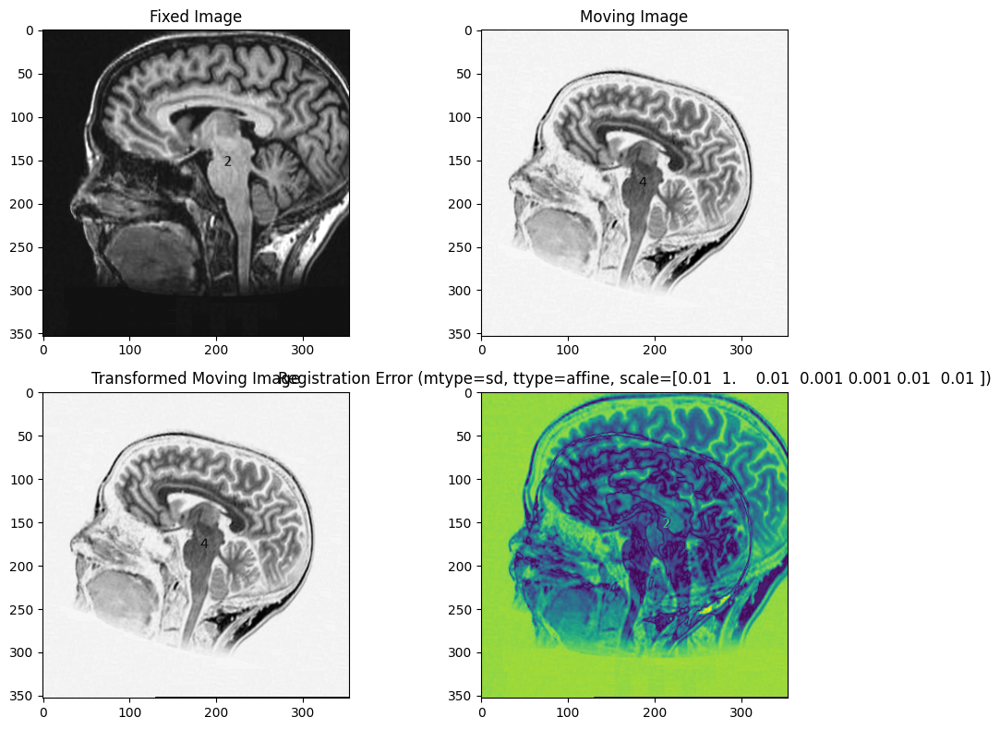


Registration took 7 sec.


In [ ]:
start = datetime.datetime.now()
Iregistered, transformation_matrix = affineReg2D("brain4.png", "brain2.png", 'sd', 'affine', tscale = [0.01, 1, 0.01, 0.001, 0.001, 0.01, 0.01])
end = datetime.datetime.now()

print(f'\nRegistration took {(end-start).seconds} sec.')

Parameters: [6.53607509e-04 9.57506357e-02 1.65814541e-03 1.00015449e+00
 1.00017796e+00 7.66770971e-04 9.34340356e-04]
ncc Error: 136.91833956867362
MSE: 38.11762487343423


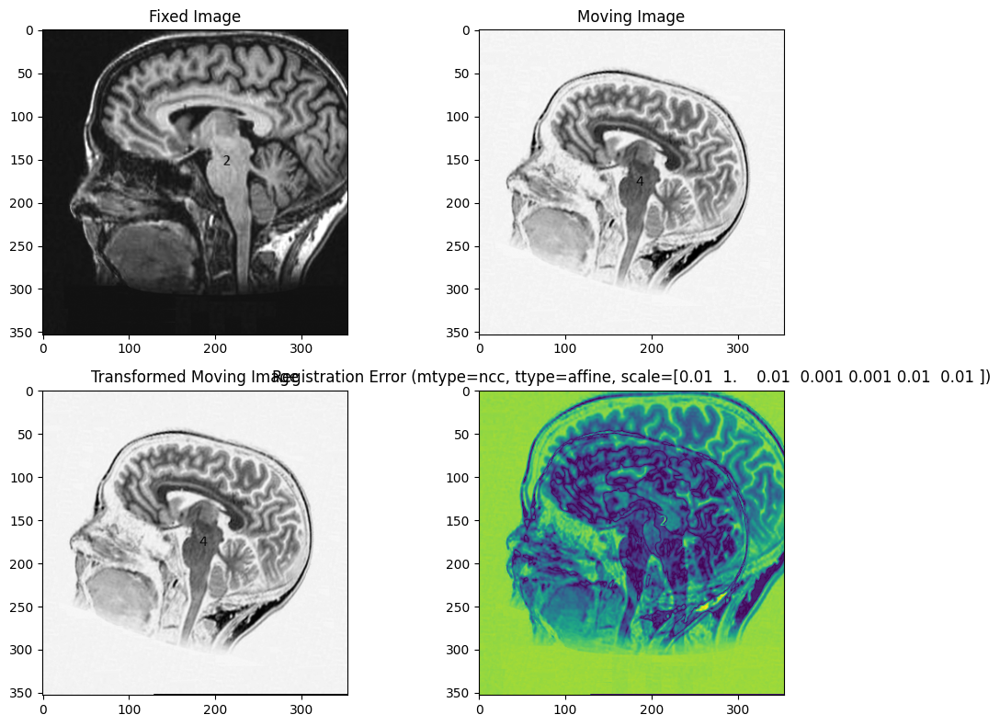


Registration took 4 sec.


In [ ]:
start = datetime.datetime.now()
Iregistered, transformation_matrix = affineReg2D("brain4.png", "brain2.png", 'ncc', 'affine', tscale = [0.01, 1, 0.01, 0.001, 0.001, 0.01, 0.01])
end = datetime.datetime.now()

print(f'\nRegistration took {(end-start).seconds} sec.')

Parameters: [7.53761728e-04 1.16931999e-01 1.58003282e-03 1.00015397e+00
 1.00015528e+00 8.69402677e-04 1.07258848e-03]
ngc Error: 21.485589543772143
MSE: 38.11896355763365


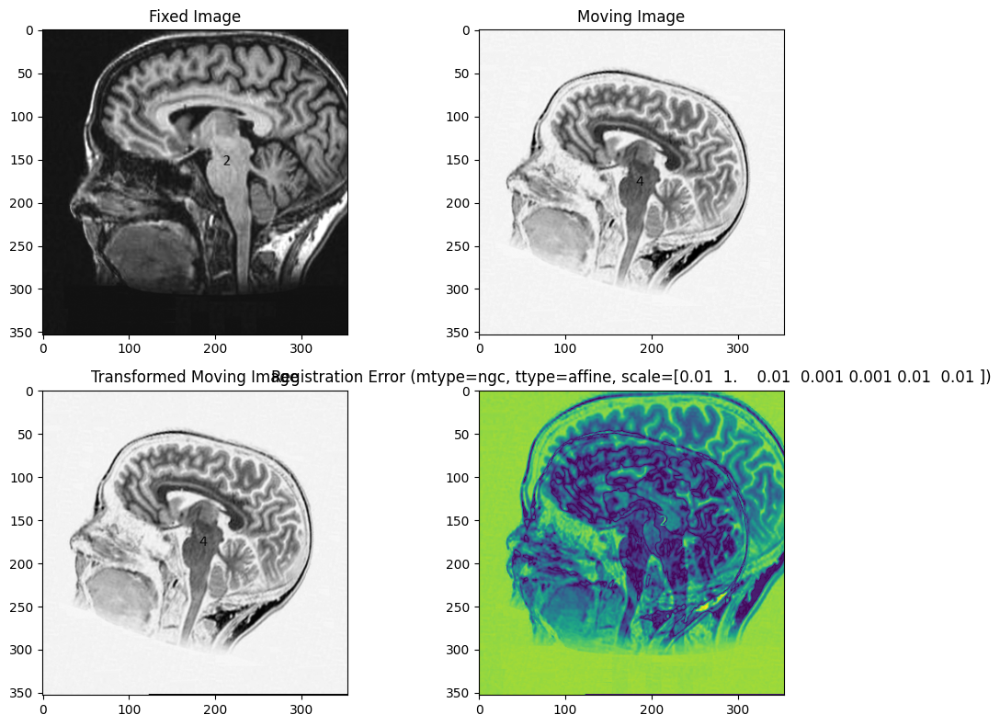


Registration took 6 sec.


In [ ]:
start = datetime.datetime.now()
Iregistered, transformation_matrix = affineReg2D("brain4.png", "brain2.png", 'ngc', 'affine', tscale = [0.01, 1, 0.01, 0.001, 0.001, 0.01, 0.01])
end = datetime.datetime.now()

print(f'\nRegistration took {(end-start).seconds} sec.')

Parameters: [0.22181866 0.27934956 0.34295617 1.4019902  1.0553461  0.02270252
 0.68166046]
sd Error: 18.57273044525646
MSE: 18.57273044525646


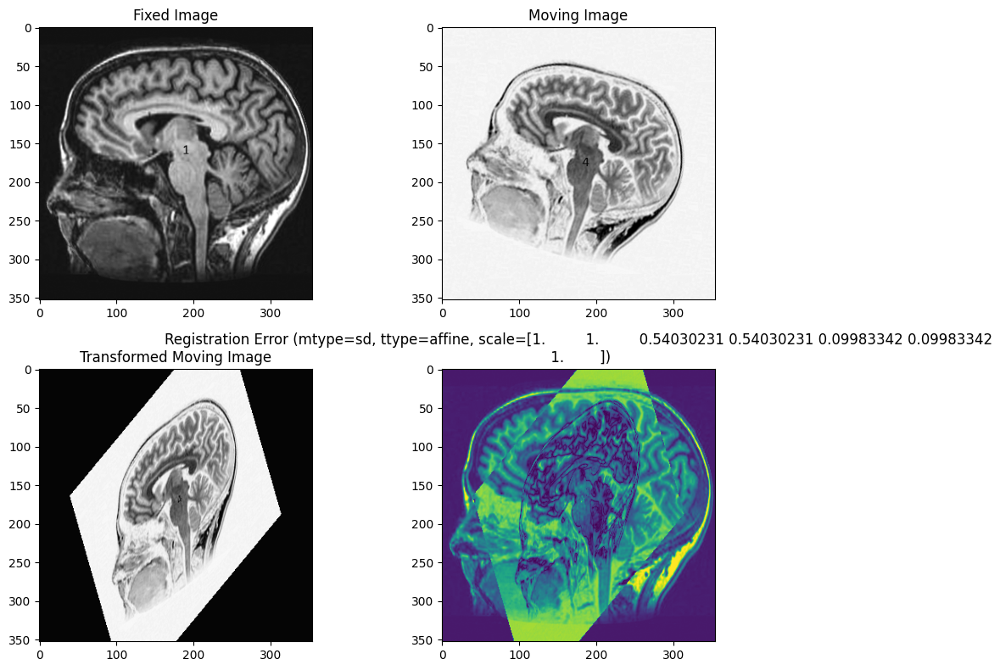


Registration took 14 sec.


In [ ]:
import math
from math import cos, sin
start = datetime.datetime.now()
Iregistered, transformation_matrix = affineReg2D("brain4.png", "brain1.png", 'sd', 'affine', tscale = [1, 1, cos(1), cos(1), sin(0.1), sin(0.1),1])
end = datetime.datetime.now()

print(f'\nRegistration took {(end-start).seconds} sec.')

Parameters: [6.71213634e-04 6.63593731e-04 3.55108510e-01 1.06094399e+00
 1.00013049e+00 6.12720464e-05 4.29856957e-01]
ncc Error: 71.96077537653069
MSE: 23.20535048765201


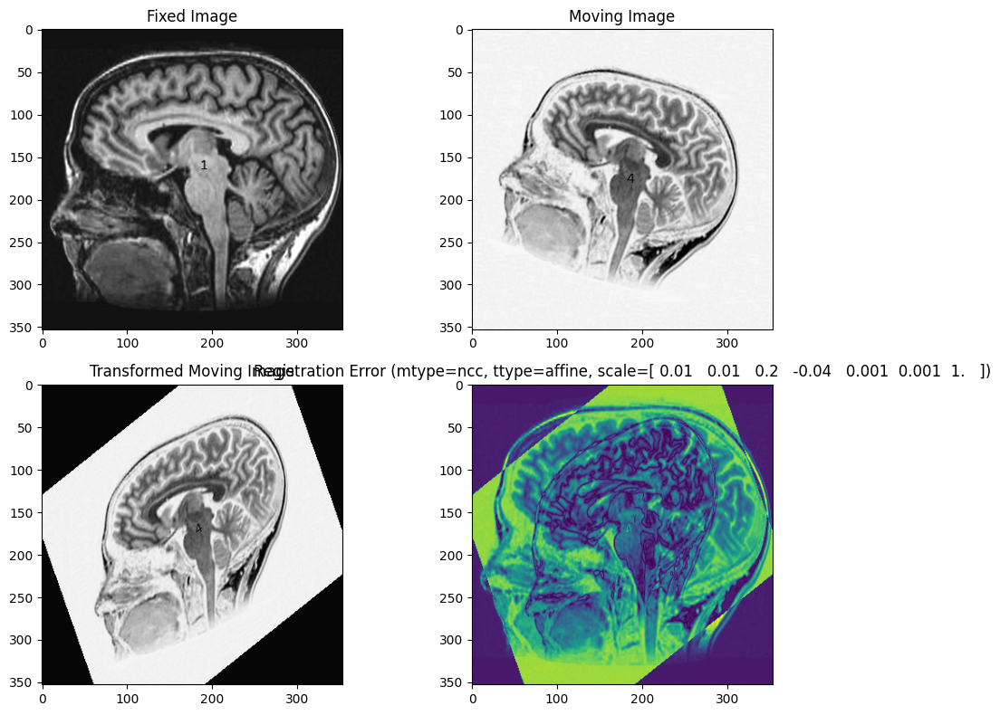


Registration took 8 sec.


In [ ]:
start = datetime.datetime.now()
Iregistered, transformation_matrix = affineReg2D("brain4.png", "brain1.png", 'ncc', 'affine', tscale = [0.01, 0.01, 0.2, -0.04, 0.001, 0.001,1])
end = datetime.datetime.now()

print(f'\nRegistration took {(end-start).seconds} sec.')

Parameters: [1.03803487e-03 1.08731891e-03 3.30975425e-02 1.00049482e+00
 1.00018166e+00 1.02639605e-04 1.22041932e-01]
ngc Error: 20.10841438197498
MSE: 34.72970531740265


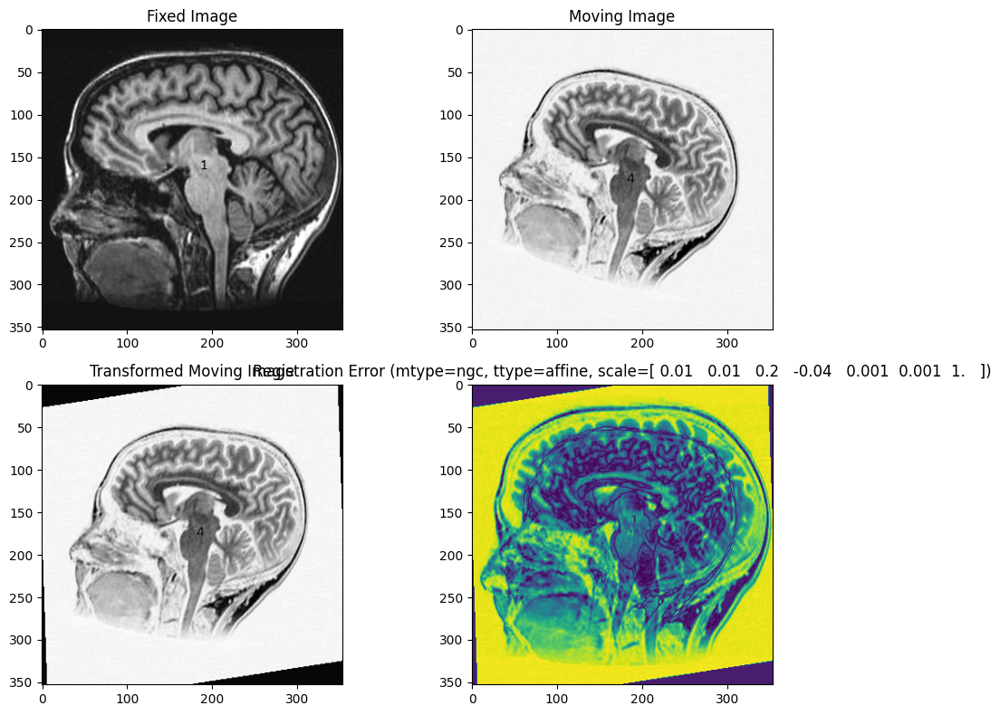


Registration took 12 sec.


In [ ]:
start = datetime.datetime.now()
Iregistered, transformation_matrix = affineReg2D("brain4.png", "brain1.png", 'ngc', 'affine', tscale = [0.01, 0.01, 0.2, -0.04, 0.001, 0.001,1])
end = datetime.datetime.now()

print(f'\nRegistration took {(end-start).seconds} sec.')

## Affine Transformation with Multi resolution

Brain 3 and 1 Affine + sd

In [ ]:
Imoving = rgb2gray(imread("brain3.png")[:,:,0:3]).astype(np.double)
Ifixed = rgb2gray(imread("brain1.png")[:,:,0:3]).astype(np.double)

moving_pyramid = create_image_pyramid(Imoving)
fixed_pyramid = create_image_pyramid(Ifixed)

Parameters: [-0.80827733 -0.49579085  0.76401571  0.76301588 -0.23484204  0.2355552 ]
sd: 0.07590285129218238
MSE: 0.07590285129218238


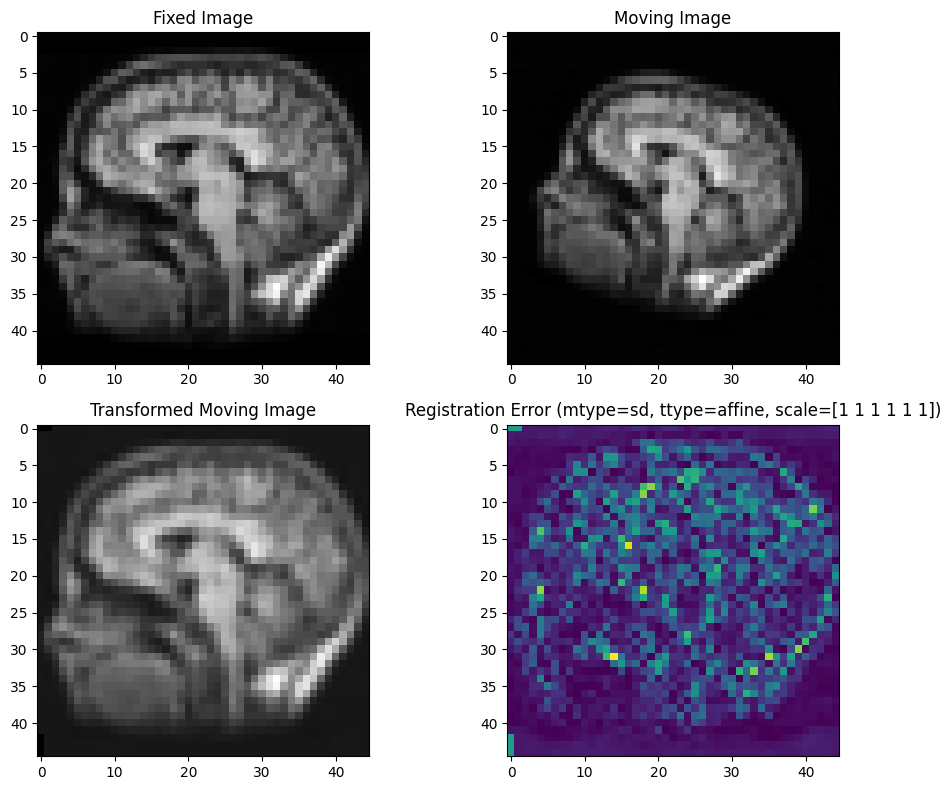

Registration at coarse level took 1 sec.


In [ ]:
coarse_tscale = [1,1,1,1,1,1]  # Coarse level (larger transformations)

start = datetime.datetime.now()
Iregistered, transformation_matrix = affineReg2D(moving_pyramid[3], fixed_pyramid[3], mtype='sd', ttype='affine', tscale=coarse_tscale)
end = datetime.datetime.now()

print(f'Registration at coarse level took {(end - start).seconds} sec.')

Optimized Parameters: [-0.87082651 -0.36940069  0.99983537  1.00083057 -0.00101624  0.00254222]
sd Error: 0.027789518076283146
MSE: 4.410673185958483


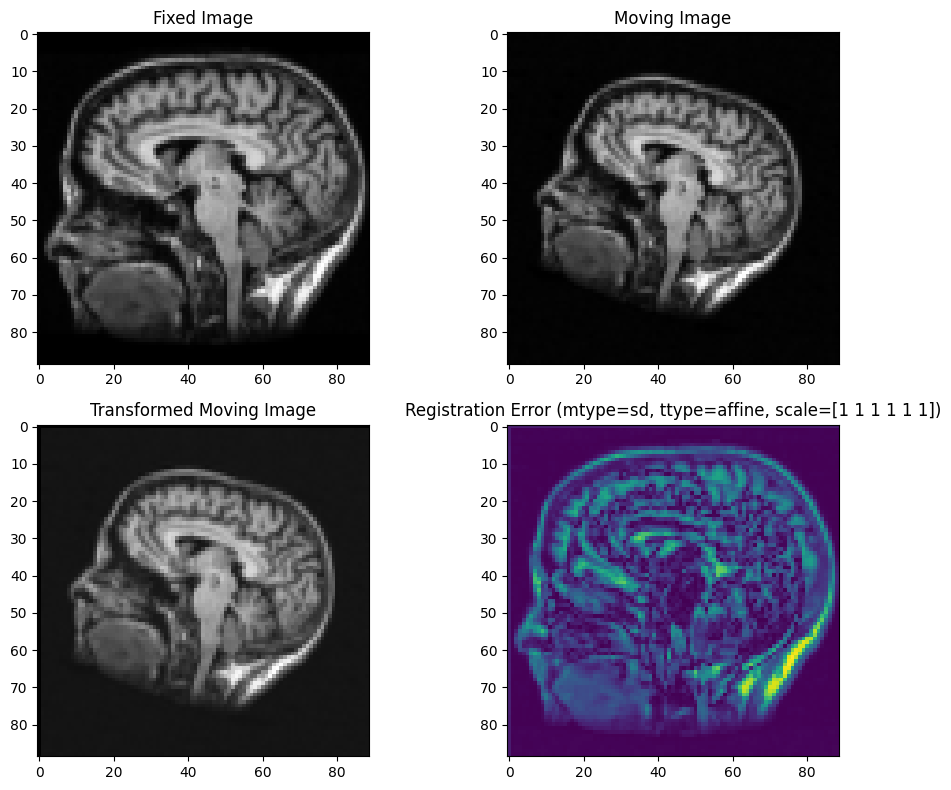

Registration at coarse level took 3 sec.


In [ ]:
coarse_tscale = [1,1,1,1,1,1]  # Coarse level (larger transformations)

start = datetime.datetime.now()
Iregistered, transformation_matrix = affineMultiReg(moving_pyramid[2], fixed_pyramid[2], mtype='sd', ttype='affine', tscale=coarse_tscale, trans_mat=transformation_matrix)
end = datetime.datetime.now()

print(f'Registration at coarse level took {(end - start).seconds} sec.')

Optimized Parameters: [-1.64468291 -1.59695007  0.76405264  0.76354976 -0.23568866  0.23519408]
sd Error: 0.02213709253927182
MSE: 0.7085601082488066


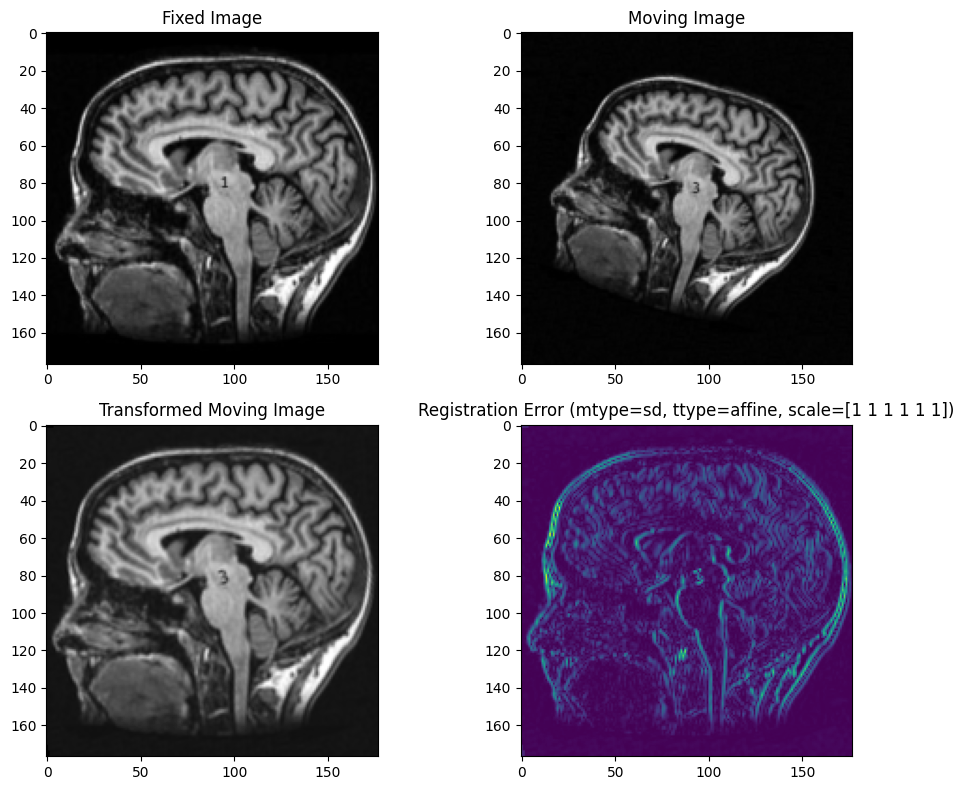

Registration at coarse level took 7 sec.


In [ ]:
coarse_tscale = [1,1,1,1,1,1]  # Coarse level (larger transformations)

start = datetime.datetime.now()
Iregistered, transformation_matrix = affineMultiReg(moving_pyramid[1], fixed_pyramid[1], mtype='sd', ttype='affine', tscale=coarse_tscale, trans_mat=transformation_matrix)
end = datetime.datetime.now()

print(f'Registration at coarse level took {(end - start).seconds} sec.')

Optimized Parameters: [-4.61699503e+00 -1.68940642e+00  1.00034585e+00  1.00045827e+00
 -1.35431026e-03  1.67368610e-03]
sd Error: 0.015657980131768445
MSE: 5.7211774758501255


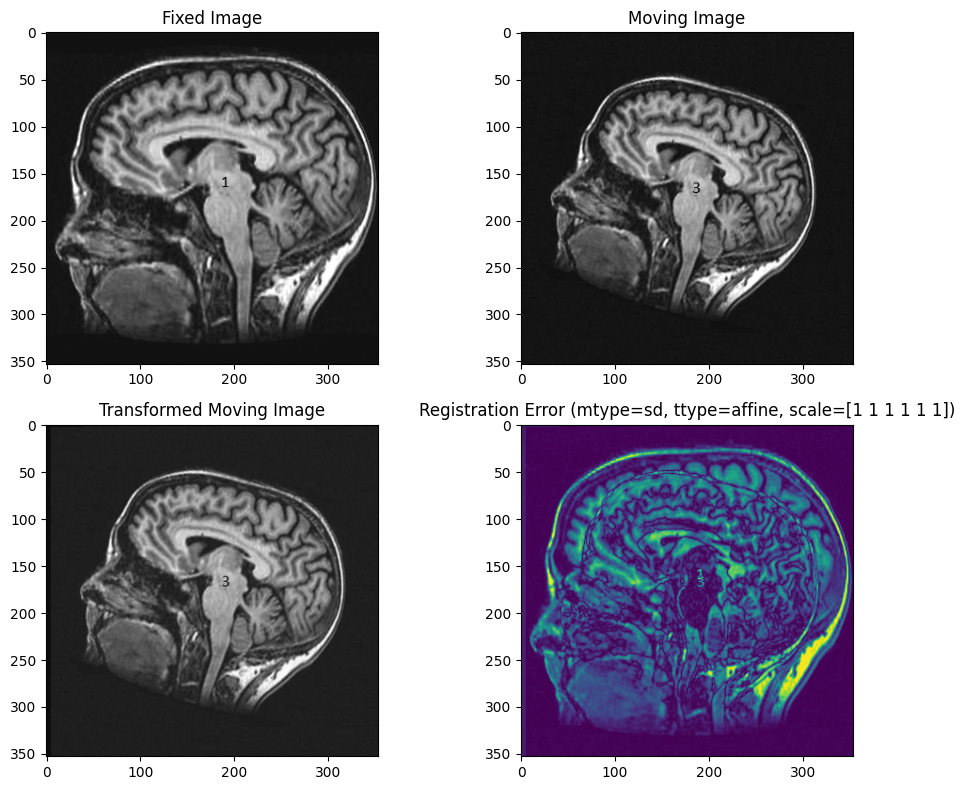

Registration at coarse level took 12 sec.


In [ ]:
coarse_tscale = [1,1,1,1,1,1]  # Coarse level (larger transformations)

start = datetime.datetime.now()
Iregistered, transformation_matrix = affineMultiReg(moving_pyramid[0], fixed_pyramid[0], mtype='sd', ttype='affine', tscale=coarse_tscale, trans_mat=transformation_matrix)
end = datetime.datetime.now()

print(f'Registration at coarse level took {(end - start).seconds} sec.')

Brain 3 -1 Affine NCC

Parameters: [-0.8006745  -0.51122516  0.76390244  0.76300058 -0.23490046  0.23646465]
ncc: -99.00472311612702
MSE: 0.0758170985993662


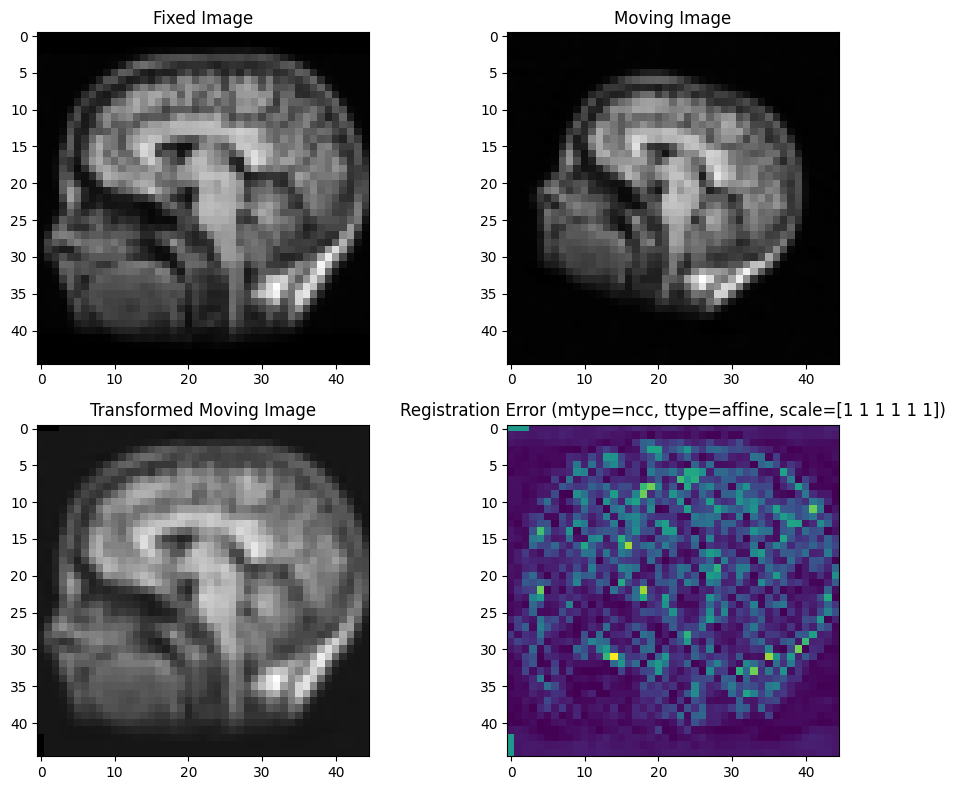

Registration at coarse level took 1 sec.


In [ ]:
coarse_tscale = [1,1,1,1,1,1]  # Coarse level (larger transformations)

start = datetime.datetime.now()
Iregistered, transformation_matrix = affineReg2D(moving_pyramid[3], fixed_pyramid[3], mtype='ncc', ttype='affine', tscale=coarse_tscale)
end = datetime.datetime.now()

print(f'Registration at coarse level took {(end - start).seconds} sec.')

Optimized Parameters: [-8.80121114e-01 -3.52353609e-01  1.00003725e+00  1.00101635e+00
 -7.56762791e-04  9.25407702e-04]
ncc Error: -99.67504036372159
MSE: 4.411320569511848


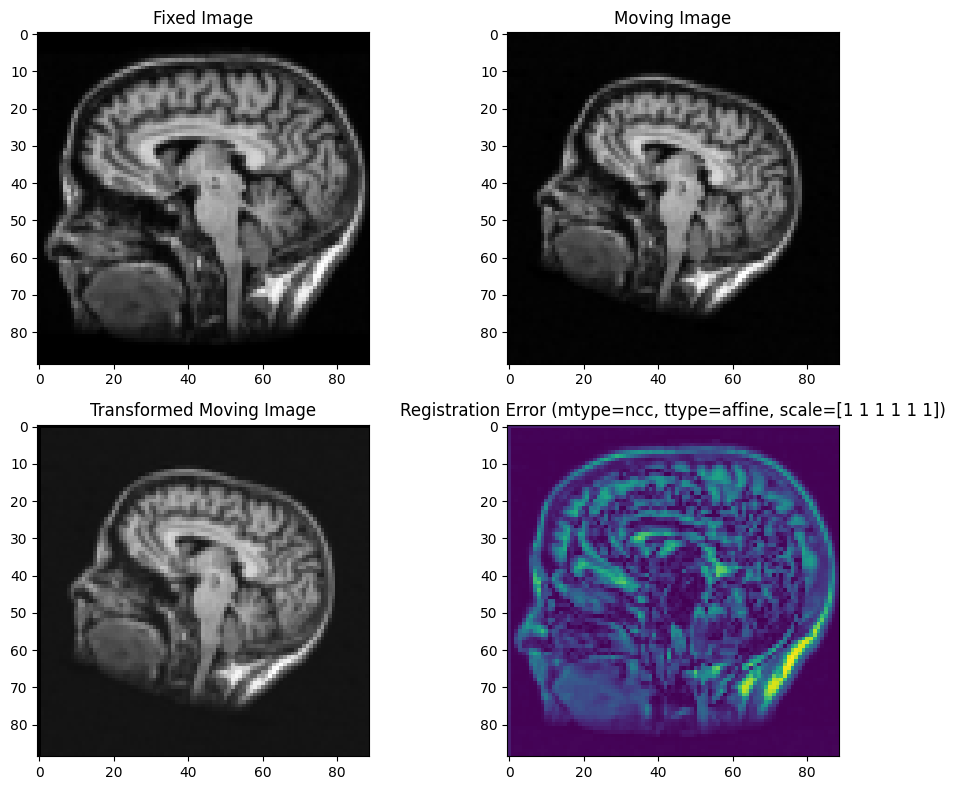

Registration at coarse level took 5 sec.


In [ ]:

start = datetime.datetime.now()
Iregistered, transformation_matrix = affineMultiReg(moving_pyramid[2], fixed_pyramid[2], mtype='ncc', ttype='affine', tscale=coarse_tscale, trans_mat=transformation_matrix)
end = datetime.datetime.now()

print(f'Registration at coarse level took {(end - start).seconds} sec.')

Optimized Parameters: [-1.69792293 -1.55752949  0.76402154  0.76376335 -0.23619834  0.23644396]
ncc Error: -99.76790748220678
MSE: 0.6778544679129305


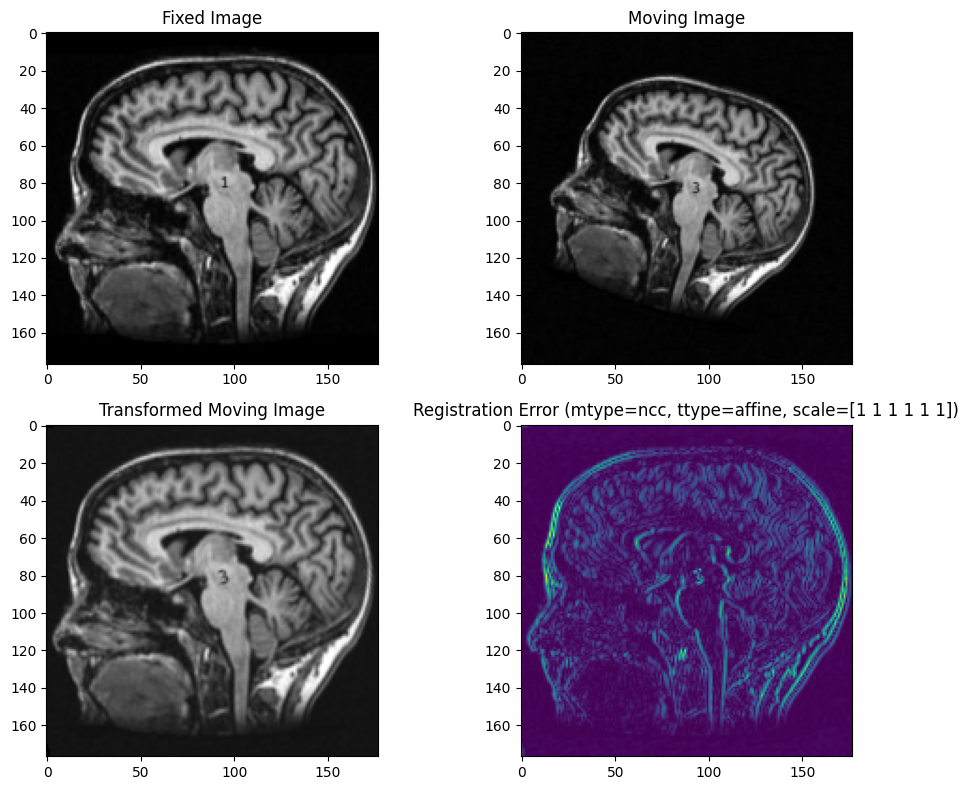

Registration at coarse level took 4 sec.


In [ ]:

start = datetime.datetime.now()
Iregistered, transformation_matrix = affineMultiReg(moving_pyramid[1], fixed_pyramid[1], mtype='ncc', ttype='affine', tscale=coarse_tscale, trans_mat=transformation_matrix)
end = datetime.datetime.now()

print(f'Registration at coarse level took {(end - start).seconds} sec.')

Optimized Parameters: [-4.55277320e+00 -1.74445974e+00  1.00007602e+00  1.00050516e+00
 -4.68519165e-04  3.16446403e-04]
ncc Error: -99.8588576819173
MSE: 5.7217711861982785


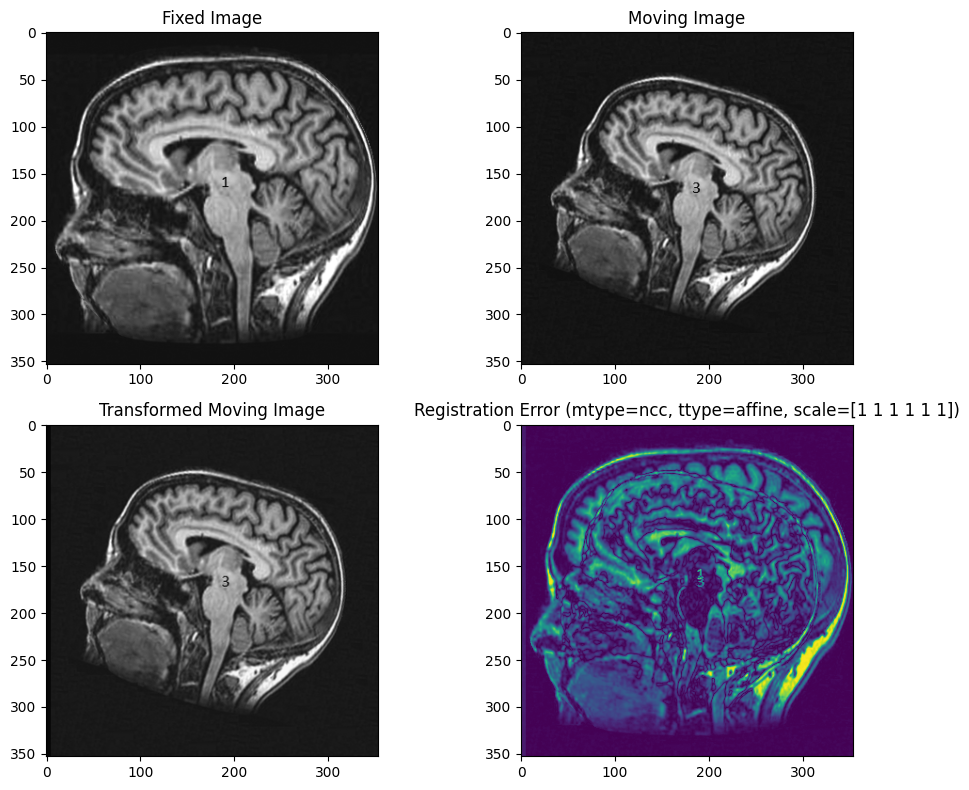

Registration at coarse level took 17 sec.


In [ ]:

start = datetime.datetime.now()
Iregistered, transformation_matrix = affineMultiReg(moving_pyramid[0], fixed_pyramid[0], mtype='ncc', ttype='affine', tscale=coarse_tscale, trans_mat=transformation_matrix)
end = datetime.datetime.now()

print(f'Registration at coarse level took {(end - start).seconds} sec.')

Brain 3 - 1 NGC

Parameters: [ 0.18542031 -0.08829169  1.18507452  0.87283779  0.06060796 -0.07775366]
ngc: -44.16800249020387
MSE: 3.86991182150637


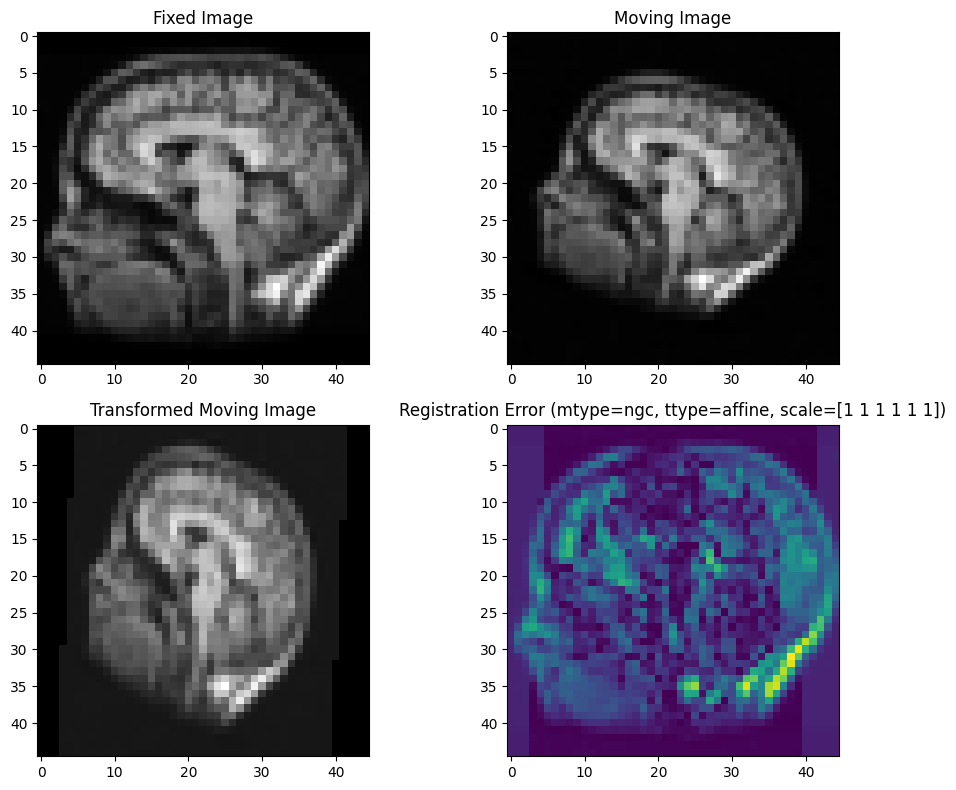

Registration at coarse level took 1 sec.


In [ ]:
coarse_tscale = [1,1,1,1,1,1]  # Coarse level (larger transformations)

start = datetime.datetime.now()
Iregistered, transformation_matrix = affineReg2D(moving_pyramid[3], fixed_pyramid[3], mtype='ngc', ttype='affine', tscale=coarse_tscale)
end = datetime.datetime.now()

print(f'Registration at coarse level took {(end - start).seconds} sec.')

Optimized Parameters: [-1.26928357 -1.13906965  0.62732821  0.85411161 -0.24351022  0.32805533]
ngc Error: -98.49166367205402
MSE: 3.0312061914662456


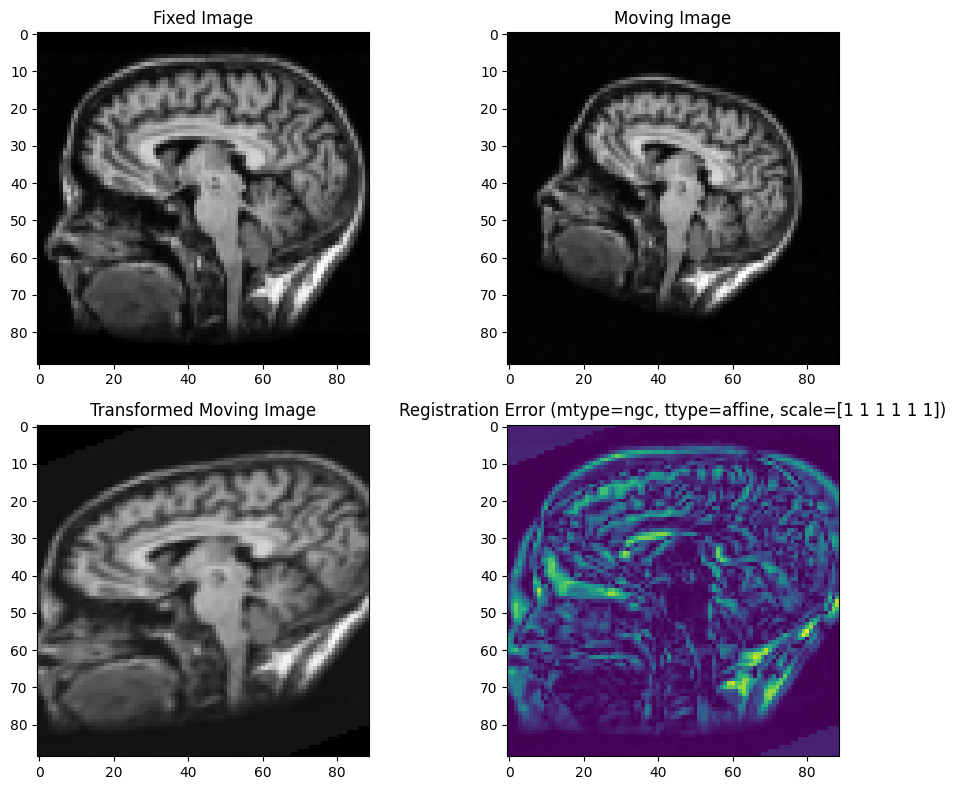

Registration at coarse level took 4 sec.


In [ ]:

start = datetime.datetime.now()
Iregistered, transformation_matrix = affineMultiReg(moving_pyramid[2], fixed_pyramid[2], mtype='ngc', ttype='affine', tscale=coarse_tscale, trans_mat=transformation_matrix)
end = datetime.datetime.now()

print(f'Registration at coarse level took {(end - start).seconds} sec.')

Optimized Parameters: [-2.06321142 -0.1845469   1.15383208  0.90414739 -0.02554617 -0.16557308]
ngc Error: -98.76071568657278
MSE: 5.428670653679946


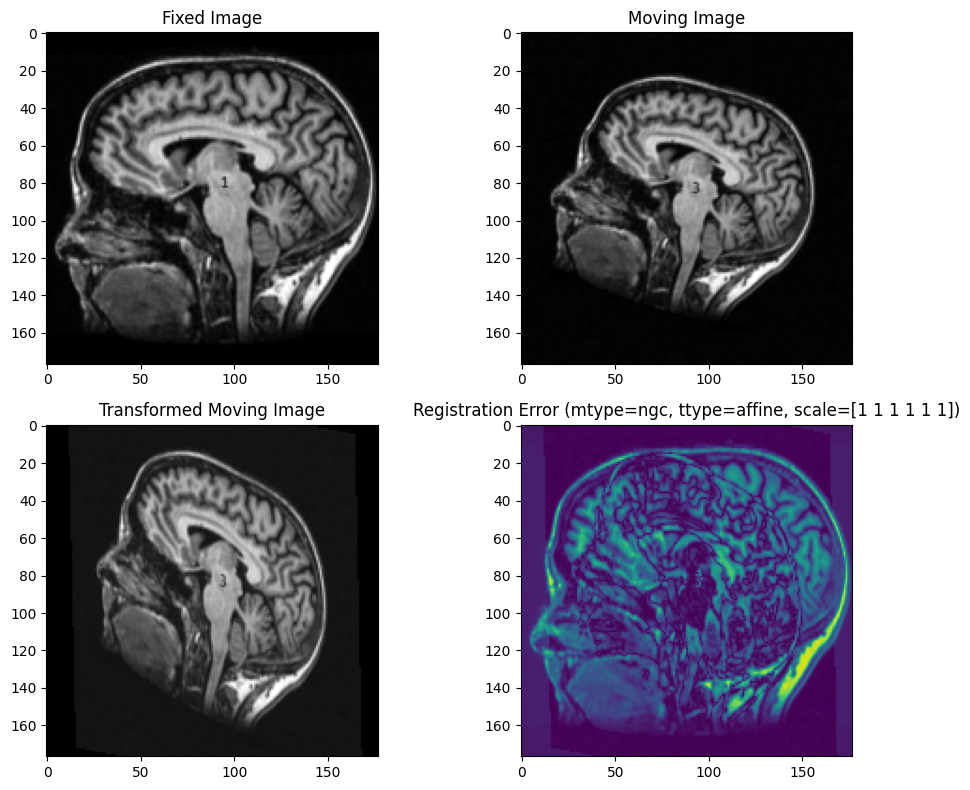

Registration at coarse level took 8 sec.


In [ ]:

start = datetime.datetime.now()
Iregistered, transformation_matrix = affineMultiReg(moving_pyramid[1], fixed_pyramid[1], mtype='ngc', ttype='affine', tscale=coarse_tscale, trans_mat=transformation_matrix)
end = datetime.datetime.now()

print(f'Registration at coarse level took {(end - start).seconds} sec.')

Optimized Parameters: [-0.02496989  0.01584113  0.65307791  0.80214074 -0.19385974  0.35378453]
ngc Error: -62.146468451799365
MSE: 5.264712016302362


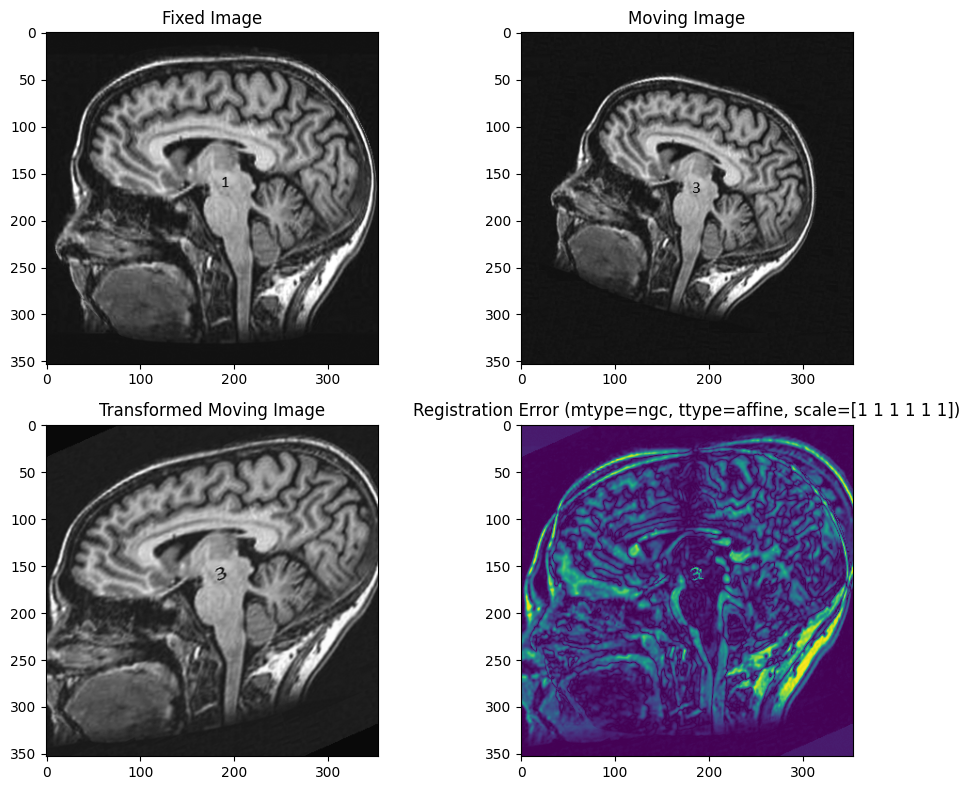

Registration at coarse level took 26 sec.


In [ ]:

start = datetime.datetime.now()
Iregistered, transformation_matrix = affineMultiReg(moving_pyramid[0], fixed_pyramid[0], mtype='ngc', ttype='affine', tscale=coarse_tscale, trans_mat=transformation_matrix)
end = datetime.datetime.now()

print(f'Registration at coarse level took {(end - start).seconds} sec.')

## **TASK 5**: For selected (representative) cases, plot the metric against iterations, computation time, registration results and final error (<u>propose a quantitative error measure</u>).

Parameters: [-2.48902459 -2.01147996  0.76385554  0.76348713 -0.23634645  0.2373644 ]
ncc: -99.71215582121985
MSE: 0.0286220643299594
Total computation time: 4.218116283416748 seconds


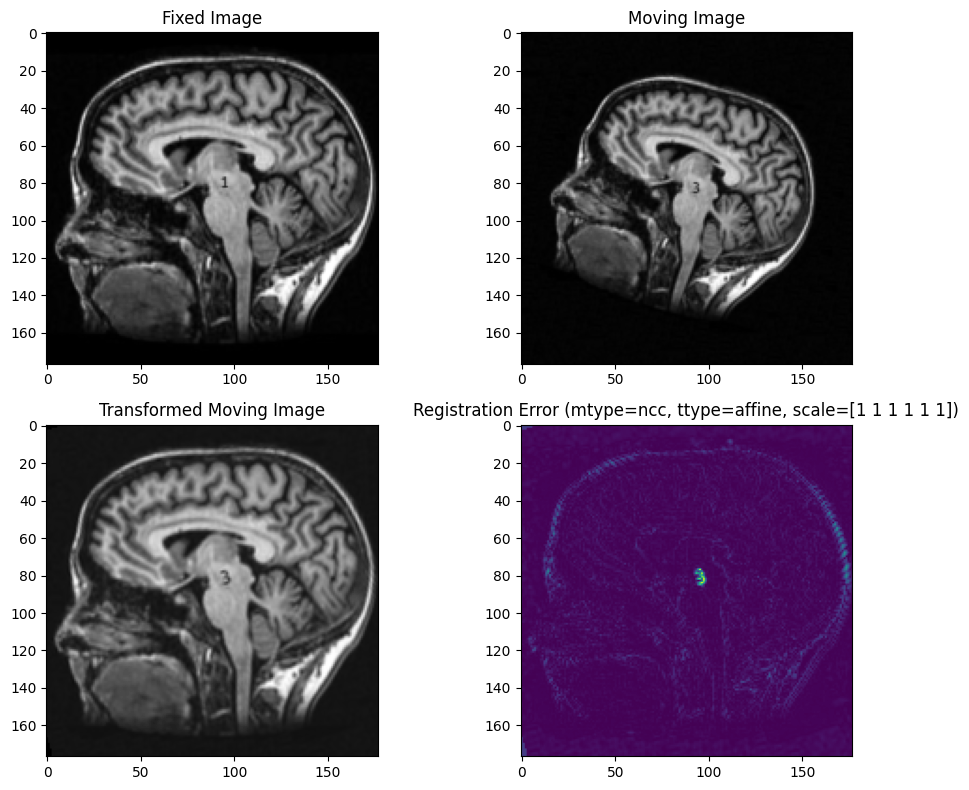

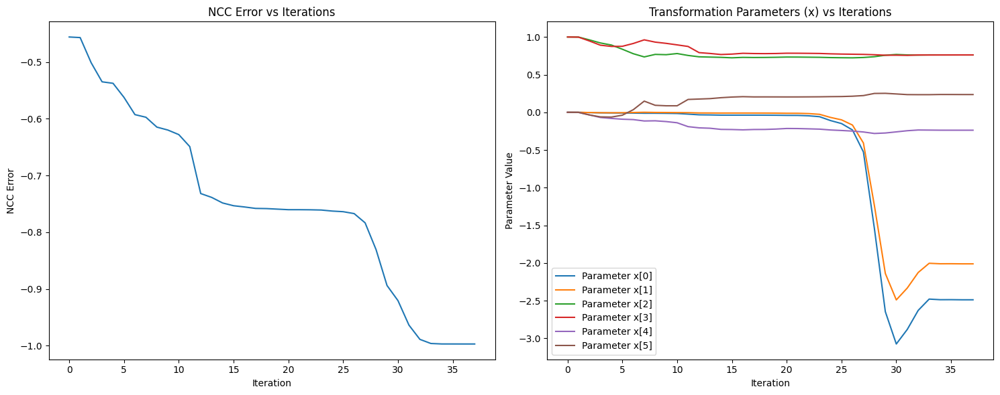

Registration at coarse level took 6 sec.


In [ ]:
coarse_tscale = [1,1,1,1,1,1]  # Coarse level (larger transformations)

start = datetime.datetime.now()
Iregistered, transformation_matrix = affineReg2D(moving_pyramid[1], fixed_pyramid[1], mtype='ncc', ttype='affine', tscale=coarse_tscale)
end = datetime.datetime.now()

print(f'Registration at coarse level took {(end - start).seconds} sec.')

Parameters: [ 2.18970320e+01 -2.39967496e+01 -1.83637572e-05]
sd: 0.38962352537149586
MSE: 0.38962352537149586
Total computation time: 8.785244464874268 seconds
Parameters for each iteration: [array([ 9.10827974e-01, -1.05709372e-01,  3.99021215e-04]), array([ 9.72715268e-01, -1.46897579e-01,  4.01184787e-04]), array([ 3.12064179e+00, -2.92235590e+00,  7.19896875e-04]), array([ 2.34312697e+01, -2.19633907e+01,  3.89557998e-03]), array([ 2.35457392e+01, -2.20833340e+01,  3.91371479e-03]), array([ 2.24974341e+01, -2.31701934e+01,  3.80438870e-03]), array([ 2.19995983e+01, -2.39589296e+01,  3.71545375e-03]), array([ 2.20123448e+01, -2.40168151e+01,  3.68508136e-03]), array([ 2.19893207e+01, -2.40245291e+01,  3.62537888e-03]), array([ 2.17869536e+01, -2.40934181e+01,  2.08465187e-03]), array([ 2.18897984e+01, -2.40539070e+01,  2.24823899e-03]), array([ 2.19033519e+01, -2.40480455e+01,  2.16139143e-03]), array([ 2.18957825e+01, -2.39322409e+01,  5.09526670e-04]), array([ 2.18954630e+01, -2.

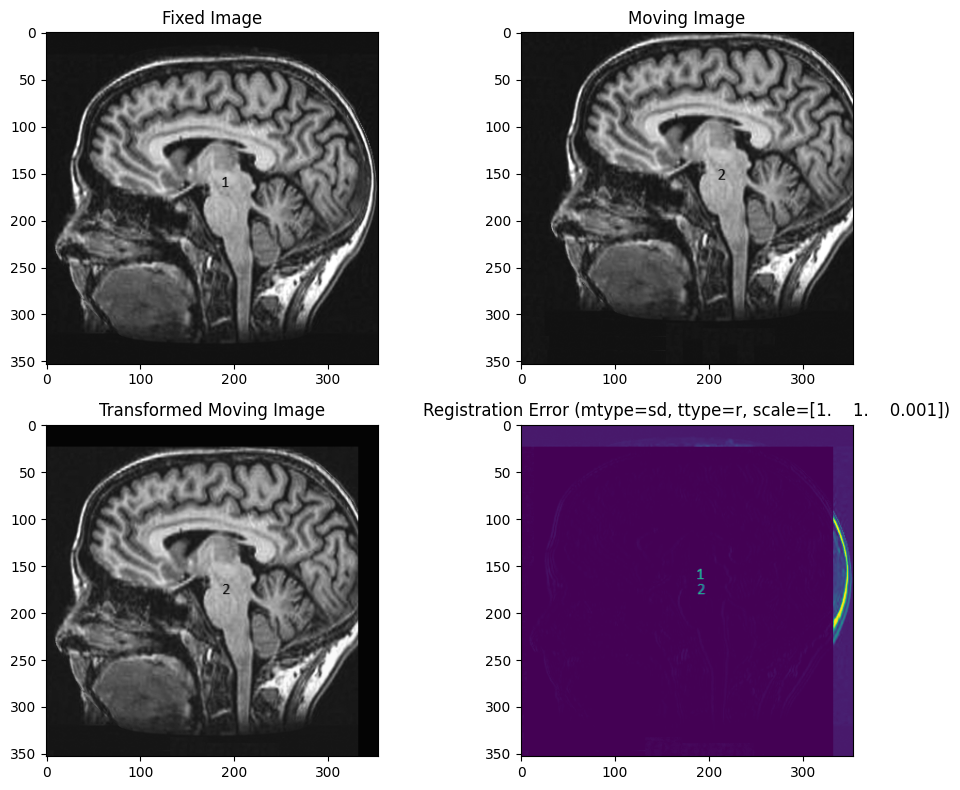

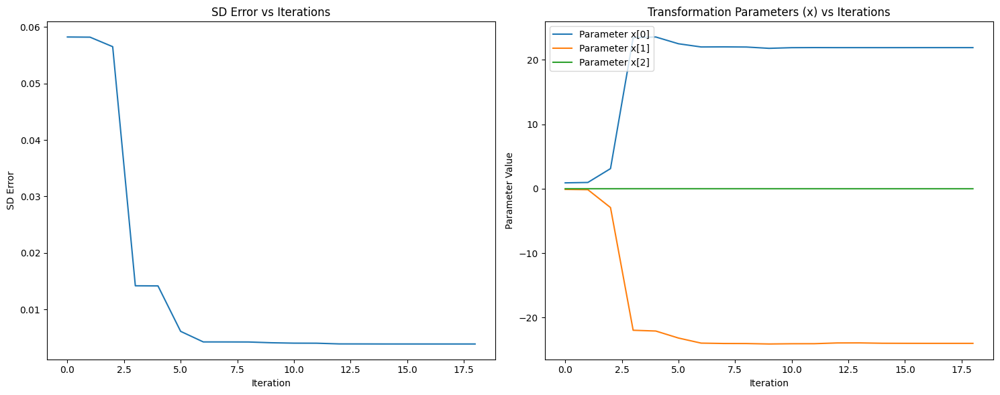


Registration took 10 sec.


In [ ]:
start = datetime.datetime.now()
Iregistered, transformation_matrix = affineReg2D("brain2.png", "brain1.png", 'sd', 'r', tscale = [1,1,0.001])
end = datetime.datetime.now()

print(f'\nRegistration took {(end-start).seconds} sec.')
# print(f'Final Error (MSE): {final_error:.5f}')

# **QUESTION 7**: Are the results what you were expecting? If not, explain why.

In this representation above we choose Registration between Brain 2 to Brain 1 with Rigid transformation with Sum of square distance.

The result: <br>
SD: 0.3896 <br>
MSE: 0.3896 <br>
Total computation time: 8.785 seconds

In this representation above we choose Registration between Brain 3 to Brain 1 with Affine transformation with NCC.

ncc: -99.71
MSE: 0.0286
Total computation time: 4.218 seconds

The results align with expectations. Rigid transformations optimize only three parameters (translation in x, y, and rotation), making them faster to compute compared to affine transformations, which handle more complex changes like scaling and shearing. This additional flexibility in affine transformations results in longer computation times due to the optimization of seven parameters.

The SD Error vs Iteration graph shows a steady decrease in error, indicating effective optimization until convergence. Minimal changes in the transformation parameters across iterations suggest that the initial parameter estimates were already close to optimal, leading to efficient registration.

In summary, rigid transformations offer faster computation due to fewer parameters, while affine transformations provide greater flexibility and accuracy, albeit at a higher computational cost. The initial parameter guesses played a key role in the registration's success.

# More Random examples

Parameters: [ 0.18542031 -0.08829169  1.18507452  0.87283779  0.06060796 -0.07775366]
ngc: -44.16800249020387
MSE: 3.86991182150637


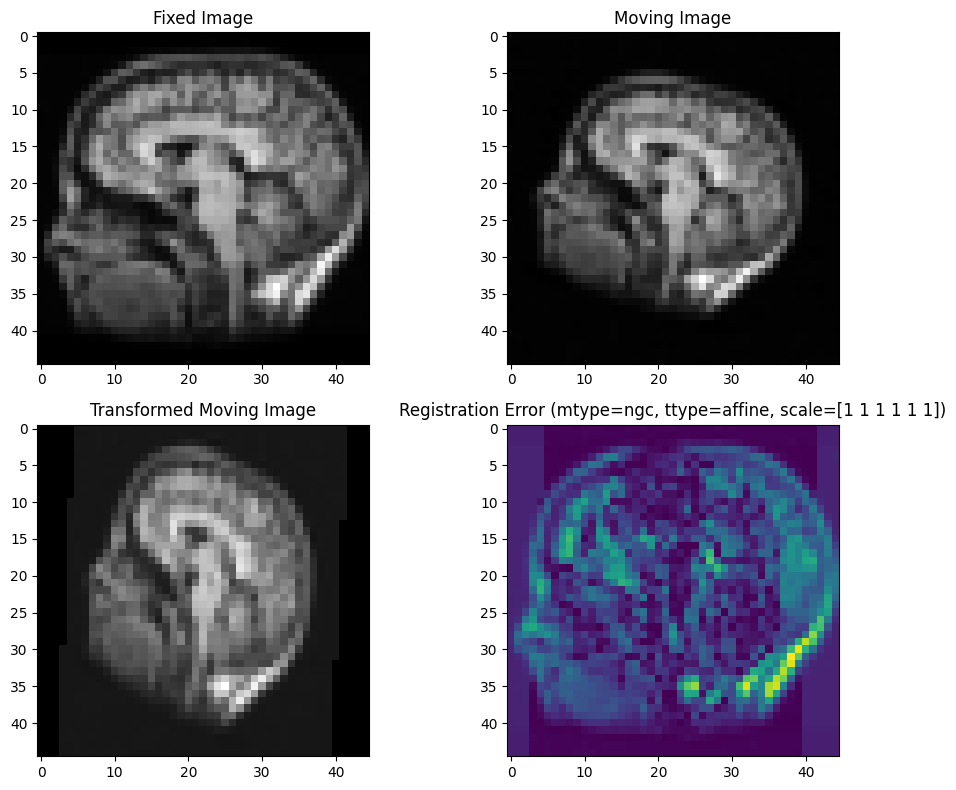

Registration at coarse level took 3 sec.


In [ ]:
coarse_tscale = [1,1,1,1,1,1]  # Coarse level (larger transformations)

start = datetime.datetime.now()
Iregistered, transformation_matrix = affineReg2D(moving_pyramid[3], fixed_pyramid[3], mtype='ngc', ttype='affine', tscale=coarse_tscale)
end = datetime.datetime.now()

print(f'Registration at coarse level took {(end - start).seconds} sec.')

Parameters: [-1.38314445 -0.99075522  0.76374034  0.76379832 -0.2365793   0.23721286]
ngc: -99.03994818450444
MSE: 0.05294242557429438


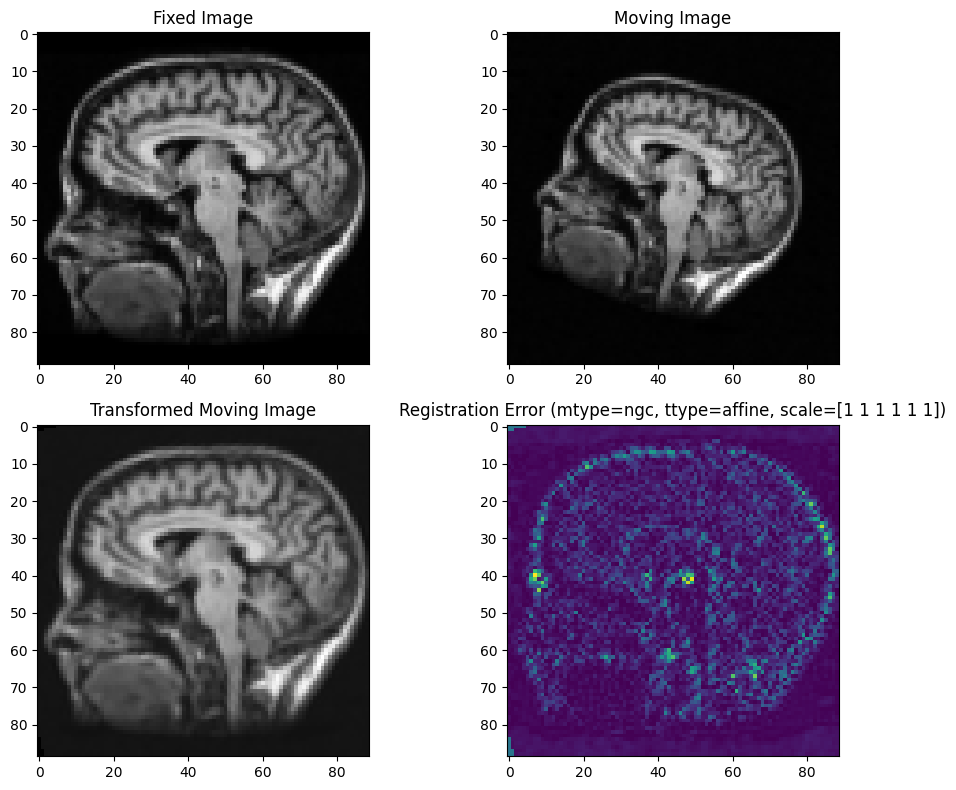

Registration at coarse level took 6 sec.


In [ ]:
coarse_tscale = [1,1,1,1,1,1]  # Coarse level (larger transformations)

start = datetime.datetime.now()
Iregistered, transformation_matrix = affineReg2D(moving_pyramid[2], fixed_pyramid[2], mtype='ngc', ttype='affine', tscale=coarse_tscale)
end = datetime.datetime.now()

print(f'Registration at coarse level took {(end - start).seconds} sec.')

Parameters: [ 0.11013841 -0.13620104  0.75275936  0.79673739 -0.18730364  0.22386522]
ngc: -62.86851860917599
MSE: 2.4101198113475353


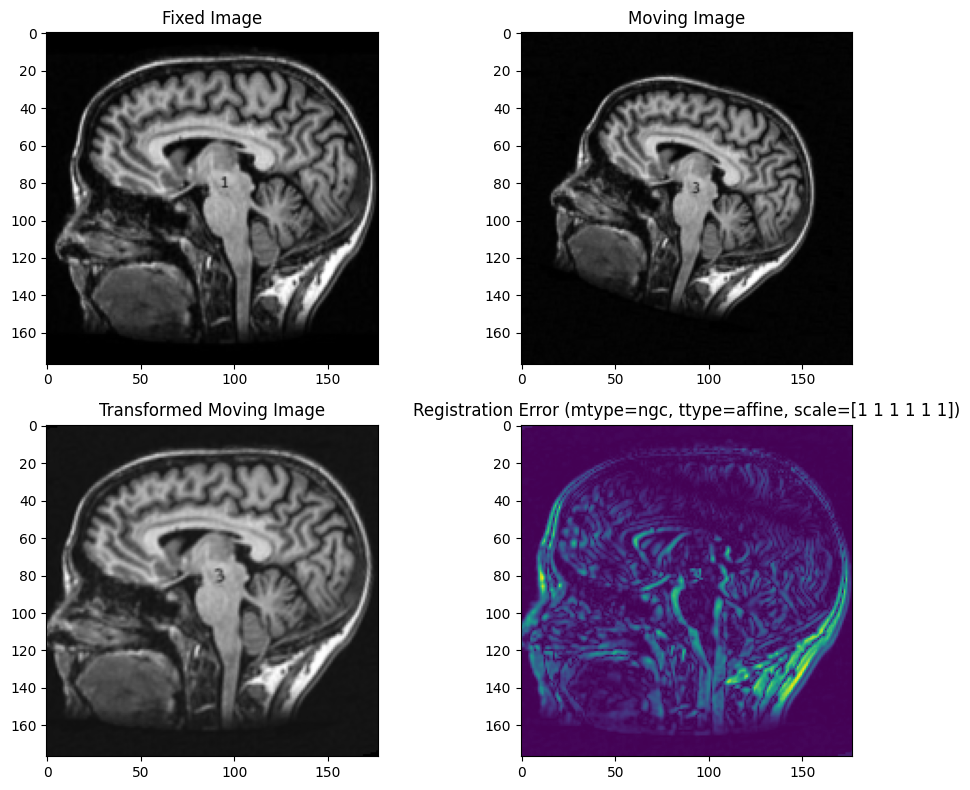

Registration at coarse level took 13 sec.


In [ ]:
coarse_tscale = [1,1,1,1,1,1]  # Coarse level (larger transformations)

start = datetime.datetime.now()
Iregistered, transformation_matrix = affineReg2D(moving_pyramid[1], fixed_pyramid[1], mtype='ngc', ttype='affine', tscale=coarse_tscale)
end = datetime.datetime.now()

print(f'Registration at coarse level took {(end - start).seconds} sec.')

Parameters: [-0.07846771 -0.1676465   0.75170732  0.79851927 -0.19482028  0.22123858]
ngc: -55.44774089290724
MSE: 2.77658855075306


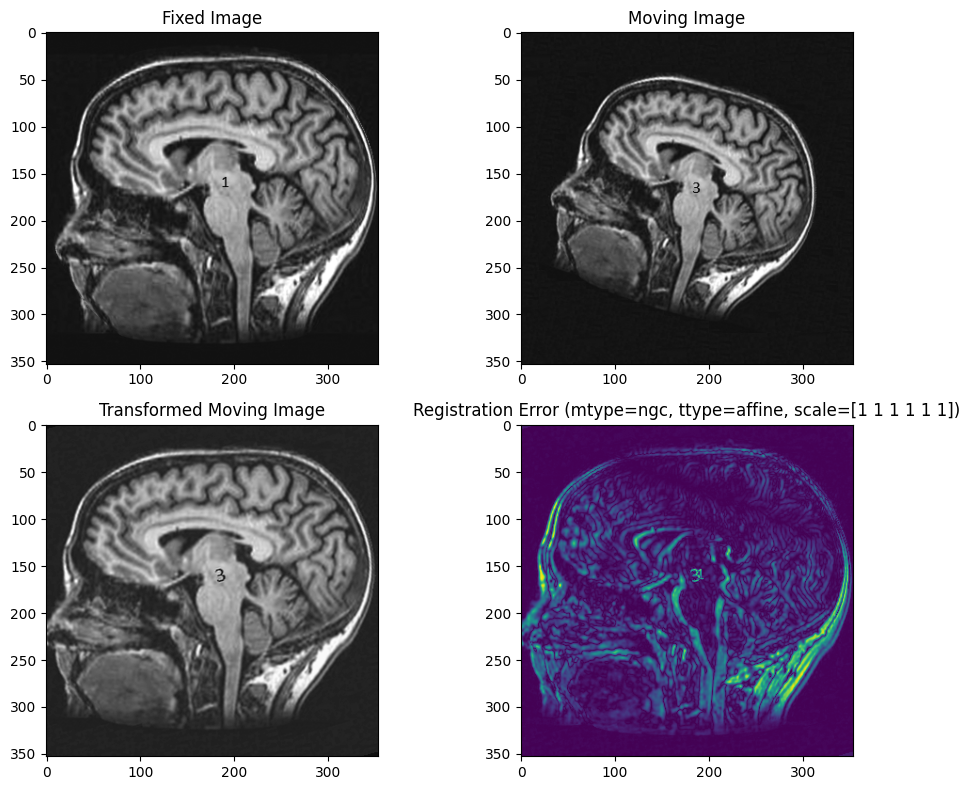

Registration at coarse level took 21 sec.


In [ ]:
coarse_tscale = [1,1,1,1,1,1]  # Coarse level (larger transformations)

start = datetime.datetime.now()
Iregistered, transformation_matrix = affineReg2D(moving_pyramid[0], fixed_pyramid[0], mtype='ngc', ttype='affine', tscale=coarse_tscale)
end = datetime.datetime.now()

print(f'Registration at coarse level took {(end - start).seconds} sec.')